# Assignment 2 - Image Matching and Face Detection<br>

### Antoine Wang 260766084

In [1]:
# Define the path for the input images
# please change this part if directory is different
path = ''

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 1 Invariance of SIFT Features 

## 1.1 Invariance Under Changes in Scale



### 1. Compute SIFT keypoints for the reference image.

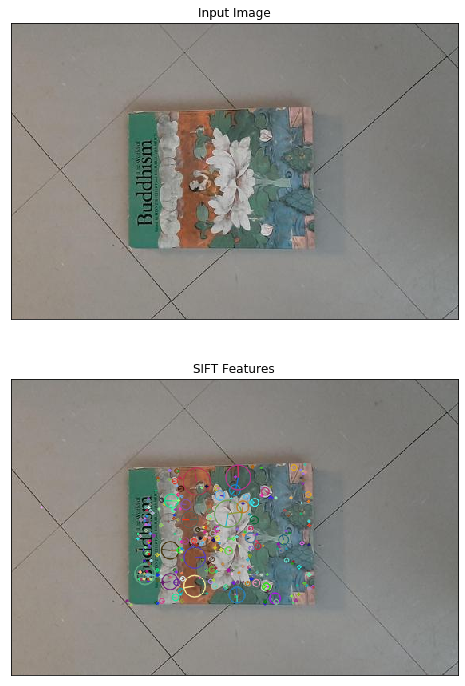

In [3]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();


# create a SIFT object
sift = cv2.xfeatures2d.SIFT_create()
keypoints = sift.detect(img_book, None)

# draw the keypoints
cv2.drawKeypoints(img_book, keypoints, img_book_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(12,12))
plt.subplot(211), plt.imshow(img_book)
plt.title("Input Image"), plt.xticks([]), plt.yticks([])
plt.subplot(212), plt.imshow(img_book_background)
plt.title("SIFT Features"), plt.xticks([]), plt.yticks([])
plt.show()


### 2. Scale reference image using scaling factors of (0.2, 0.5, 0.8, 1.25, 2, 5).

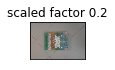

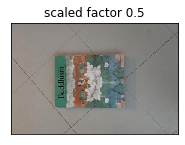

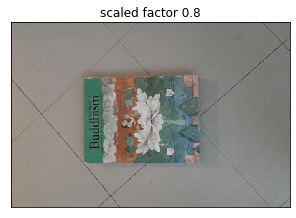

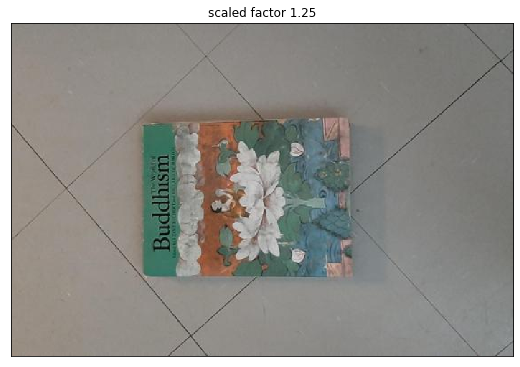

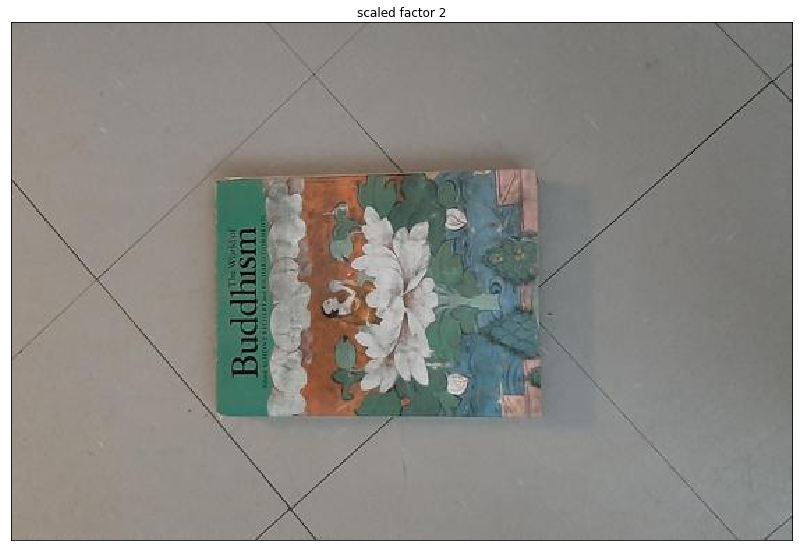

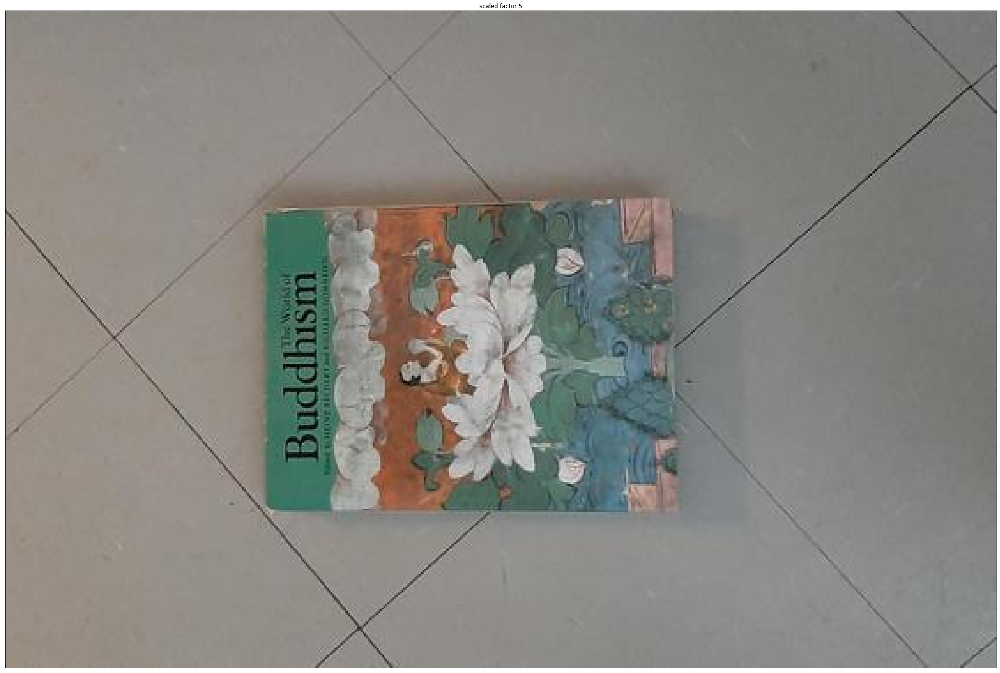

In [4]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
imgs_resized = []

scale = [0.2, 0.5, 0.8, 1.25, 2, 5]
for i in scale:
    
    # multiply different scale to get the desired output
    width = int(img_book.shape[1] * i)
    height = int(img_book.shape[0] * i)
    dim = (width, height)
    
    # resize image
    resized = cv2.resize(img_book, dim, interpolation = cv2.INTER_AREA)
    
    imgs_resized.append(resized)
    
    plt.figure(figsize=((int)(resized.shape[0]/50),(int)(resized.shape[1]/50)))
    plt.imshow(resized), plt.title("scaled factor " + str(i)), plt.xticks([]), plt.yticks([])
    



### 3. Compute SIFT keypoints for the transformed images. 

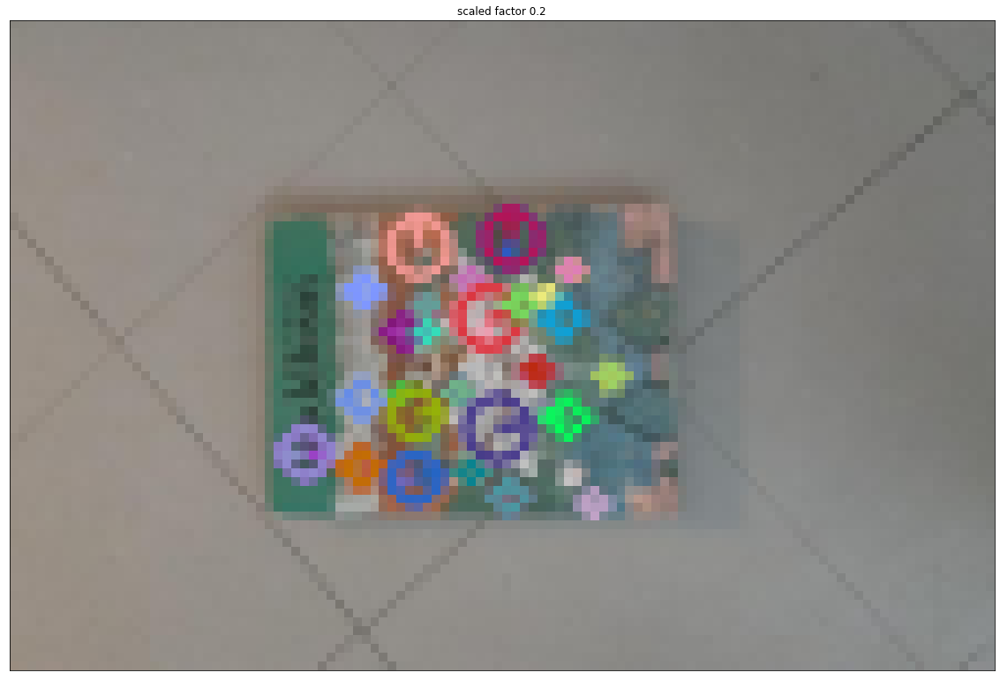

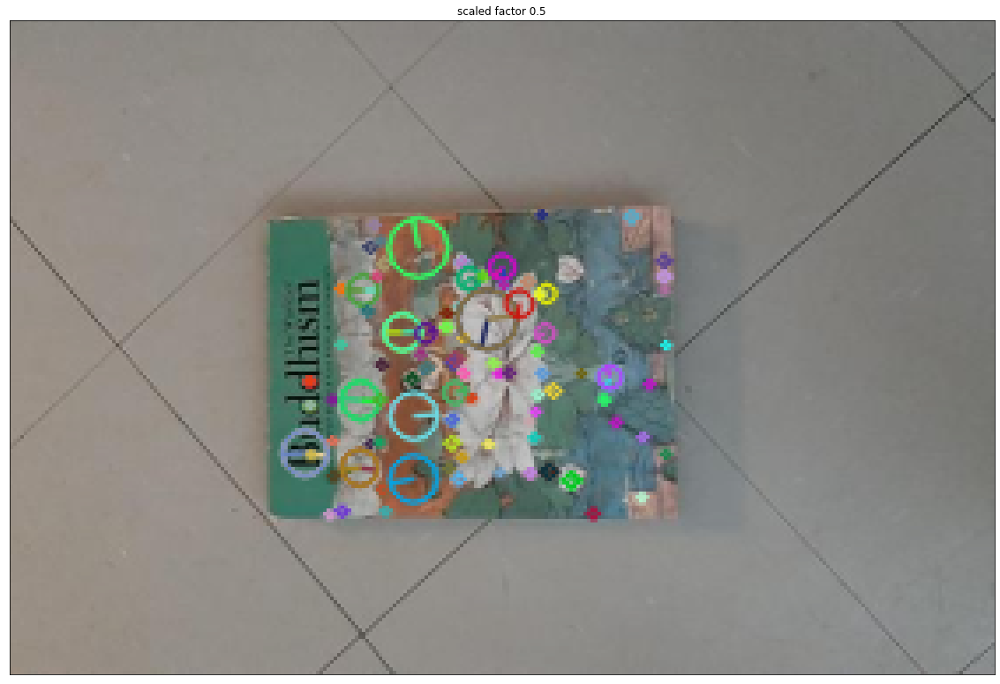

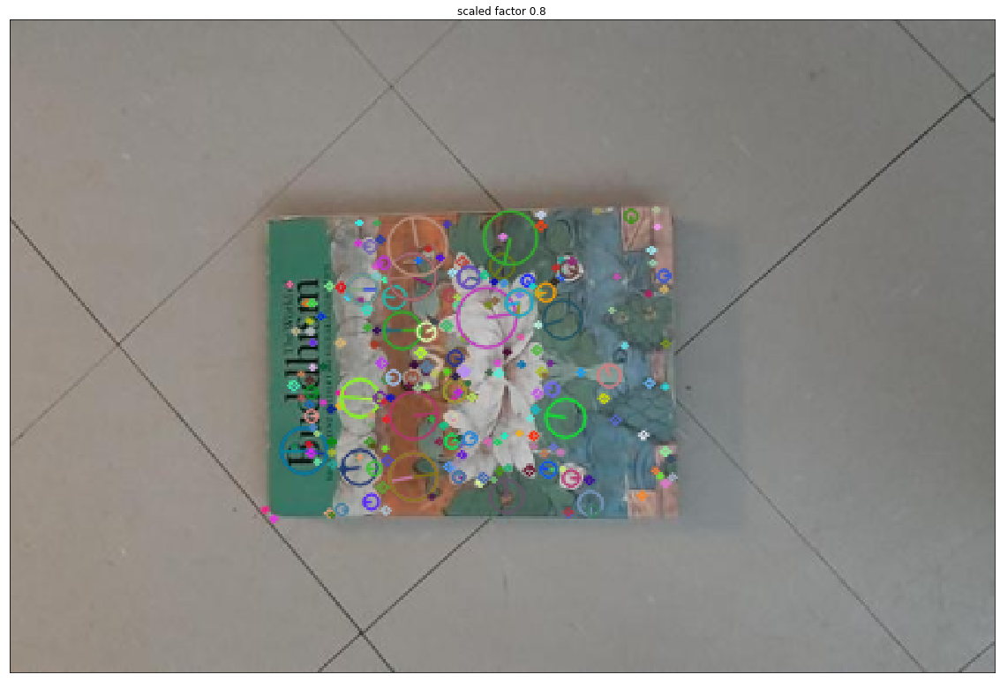

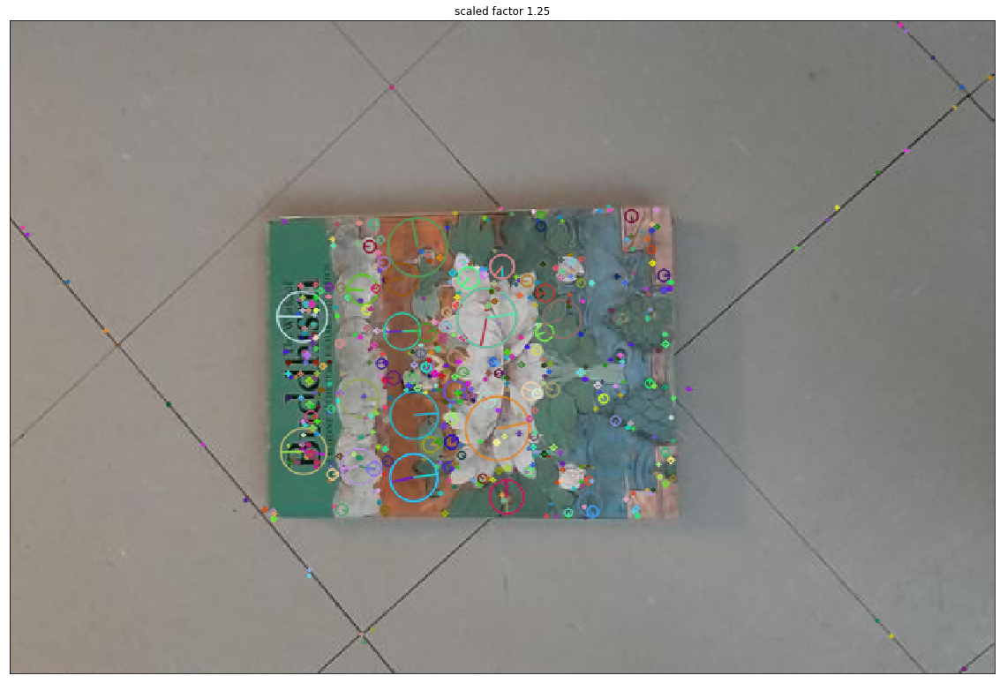

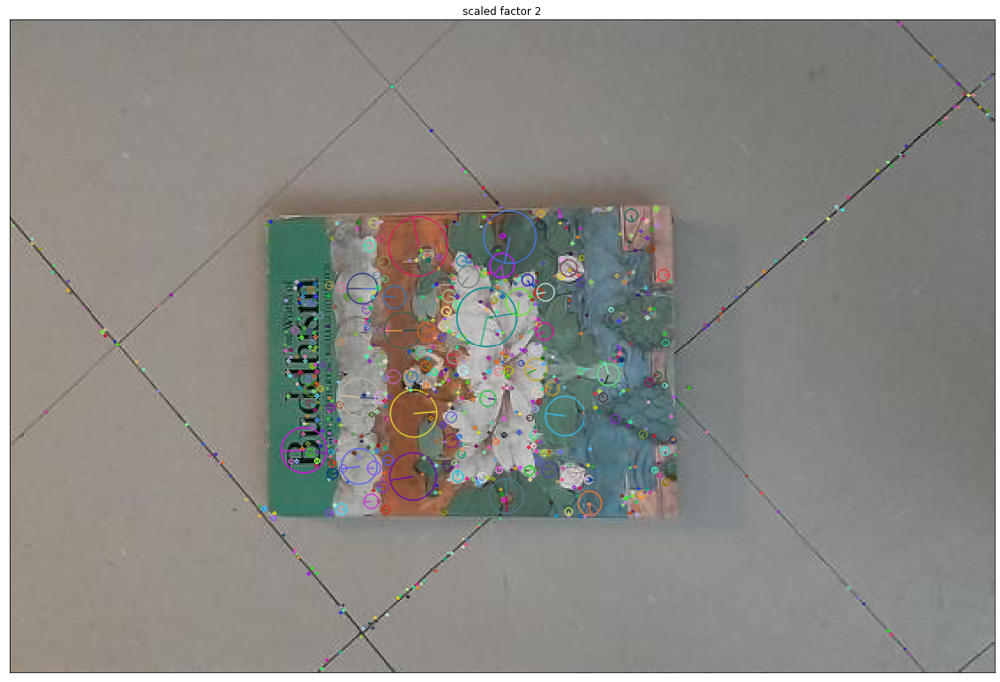

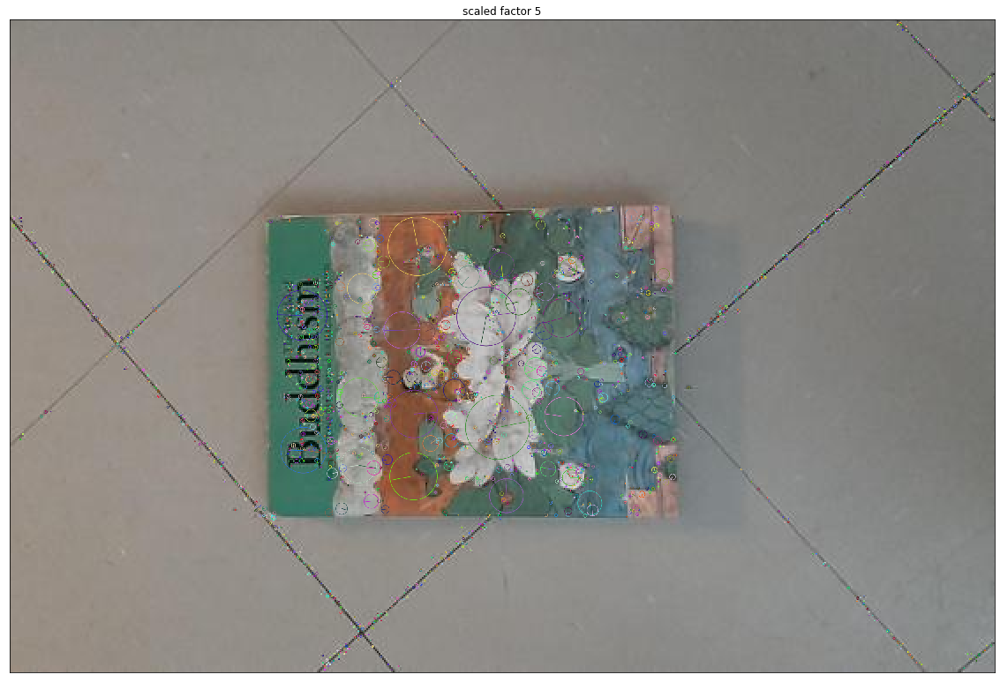

In [5]:
index = 0

# Define two lists, one list holding keypoint positions and one hoiding descriptors
# there should be in total 6 elements
descriptors_list = []
keypoints_list = []

plot_scale = 20
for img in imgs_resized:
    # create a SIFT object
    sift = cv2.xfeatures2d.SIFT_create()
    
    # Compute the keypoints/descriptors
    keypoints1,descriptors1 = sift.detectAndCompute(img,None)
    
    descriptors_list.append(descriptors1)
    keypoints_list.append(keypoints1)
 
    img_background = img.copy()

    # draw the keypoints
    cv2.drawKeypoints(img, keypoints1, img_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    # dynamically adjust the size of output picture, so that the picture wont get too big
    display_size1 = (int)(resized.shape[0]/plot_scale) if (int)(resized.shape[0]/plot_scale)< 2* plot_scale else plot_scale
    display_size2 = (int)(resized.shape[1]/plot_scale) if (int)(resized.shape[1]/plot_scale)< 2* plot_scale else plot_scale
    
    plt.figure(figsize=(display_size1,display_size2))
    plt.imshow(img_background), plt.title("scaled factor " + str(scale[index])), plt.xticks([]), plt.yticks([])
    
    index = index + 1; 


### 4. Match all keypoints of the reference image to the transformed images using a brute-force method. 


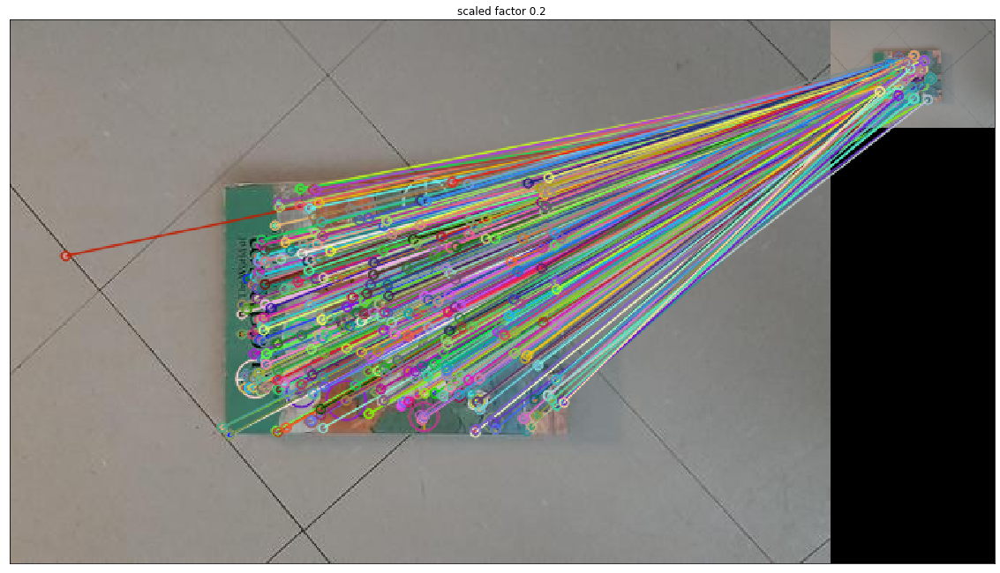

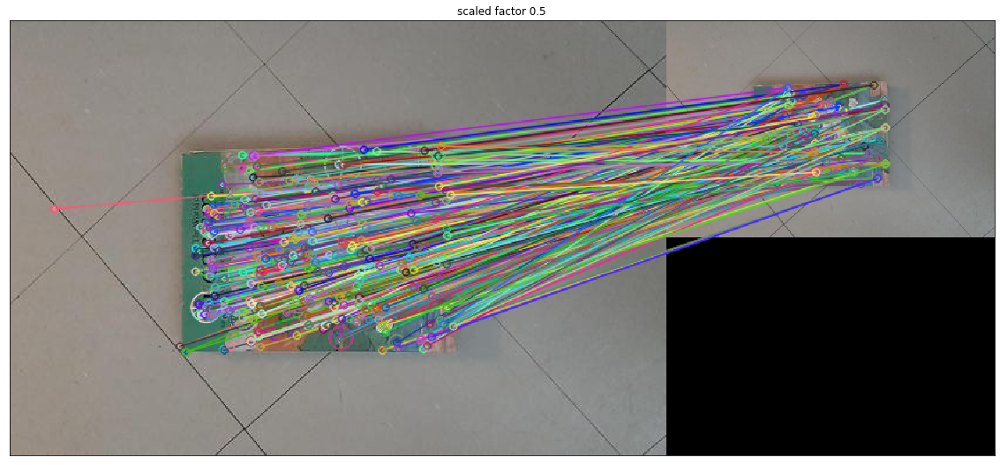

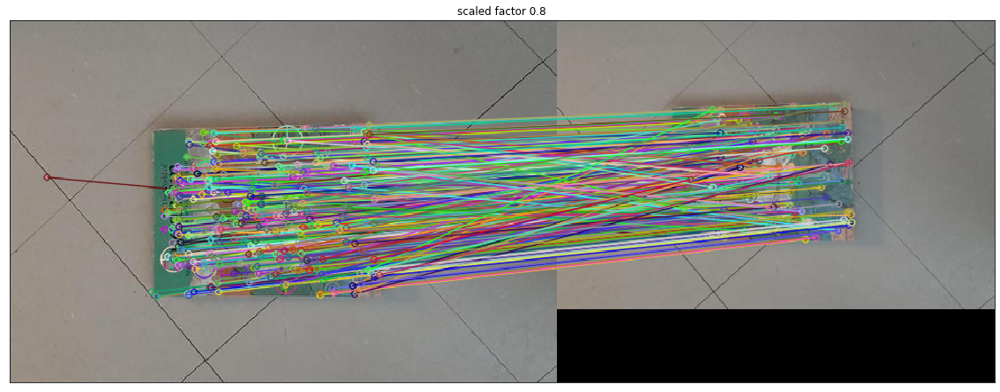

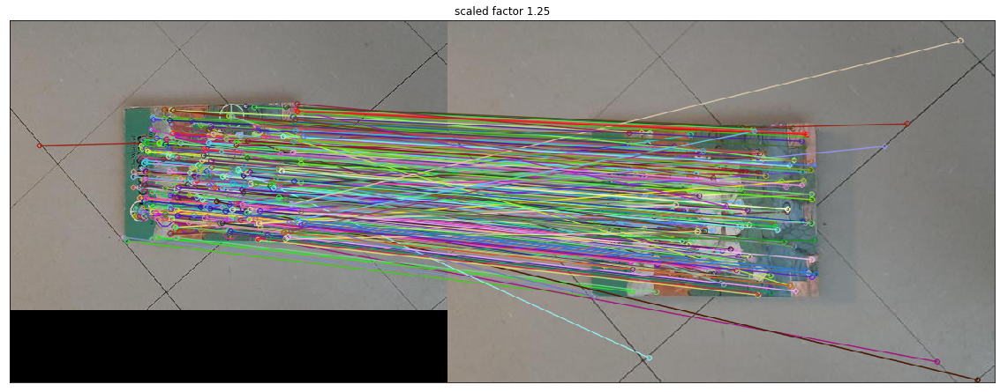

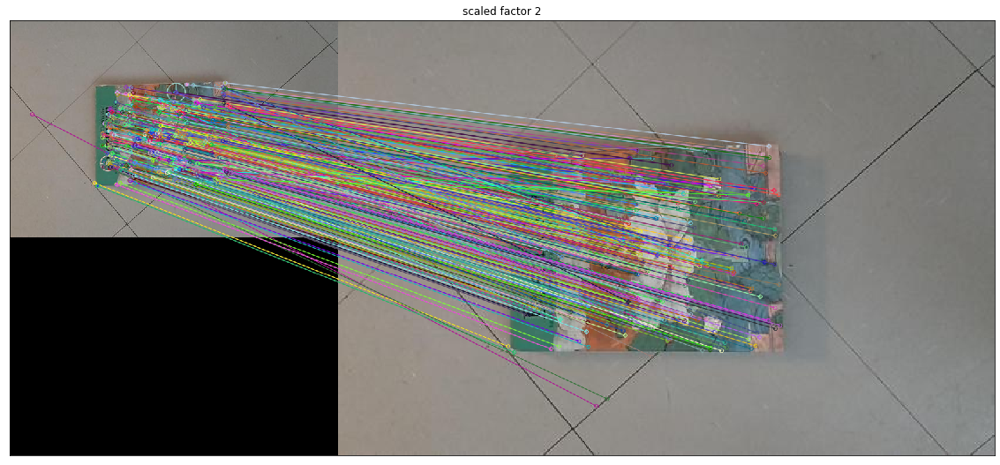

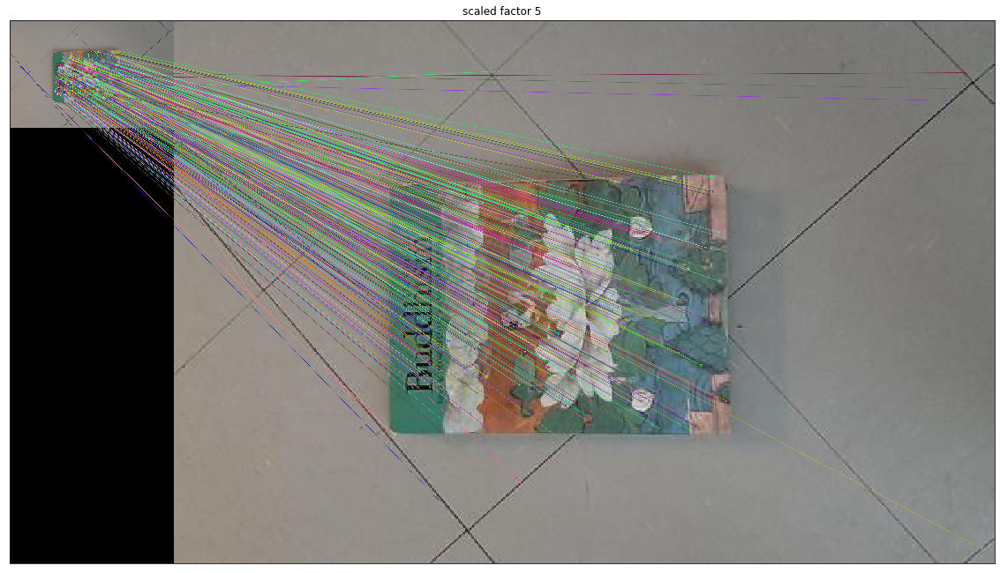

In [6]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();

# create a match list, each time the original image match with a resized image, add one matchor obj in this list
matches_list = []

i = 0

# SIFT feature and des for original image
sift = cv2.xfeatures2d.SIFT_create()
keypoints_original,descriptors_original = sift.detectAndCompute(img_book,None)
cv2.drawKeypoints(img_book, keypoints_original, img_book_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

for i in range (0, len(descriptors_list)):
    # Use a brute force method
    bf = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors_original,descriptors_list[i]) 
    
    # add each matchor to the list
    matches_list.append(matches);
    
    # draw line with each pair
    img3 = cv2.drawMatches(img_book_background,keypoints_original,
                           imgs_resized[i],keypoints_list[i], 
                           matches, None, flags=2)
    plt.figure(figsize=(20,20))
    plt.imshow(img3), plt.title("scaled factor " + str(scale[i])), plt.xticks([]), plt.yticks([])

### 5. Sort matching keypoints according to the matching distance. 

In [7]:
# sort each matchor in the 6 matches
for i in range (0, len(scale)):
    matches_list[i]  = sorted(matches_list[i], key = lambda x:x.distance)
    print("for scale " + str(scale[i]) + " :")
    
    # for each resized image, print out the first 5 elements to check if sorted
    for j in range (0,5):    
        print(matches_list[i][j].distance)

for scale 0.2 :
18.357559204101562
21.954498291015625
22.781572341918945
26.248809814453125
28.213472366333008
for scale 0.5 :
8.246211051940918
9.848857879638672
10.488088607788086
10.72380542755127
12.247448921203613
for scale 0.8 :
8.246211051940918
9.219544410705566
11.575837135314941
11.789826393127441
13.076696395874023
for scale 1.25 :
7.549834251403809
10.29563045501709
10.862780570983887
14.03566837310791
14.387495040893555
for scale 2 :
3.464101552963257
3.464101552963257
3.605551242828369
4.0
4.358899116516113
for scale 5 :
9.643651008605957
10.29563045501709
11.661903381347656
11.661903381347656
14.317821502685547


### 6. Display top ten matched keypoints for each pair of reference image and a transformed image. 


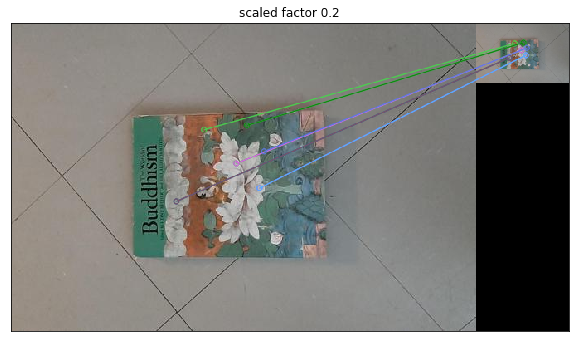

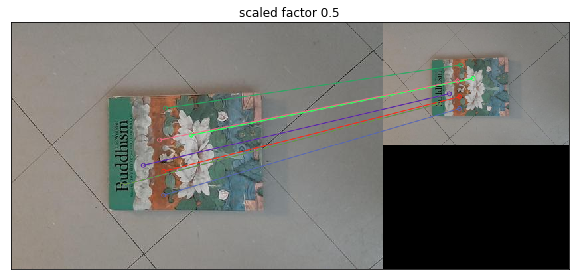

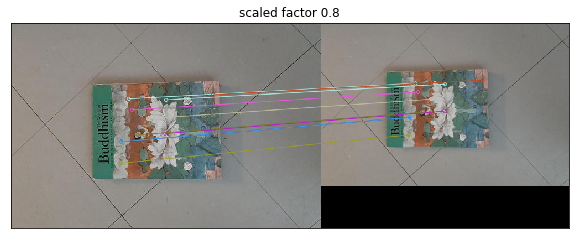

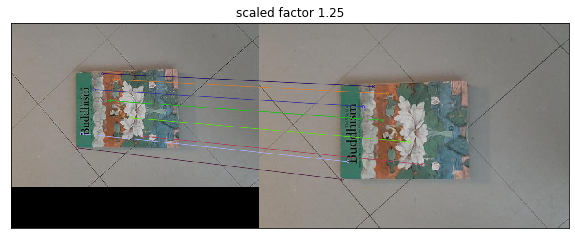

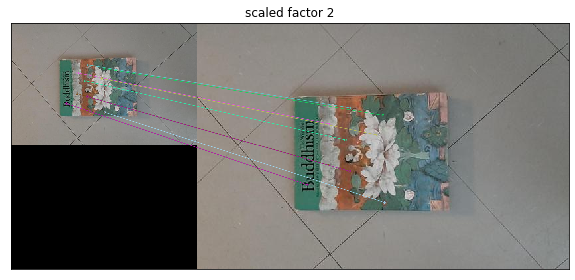

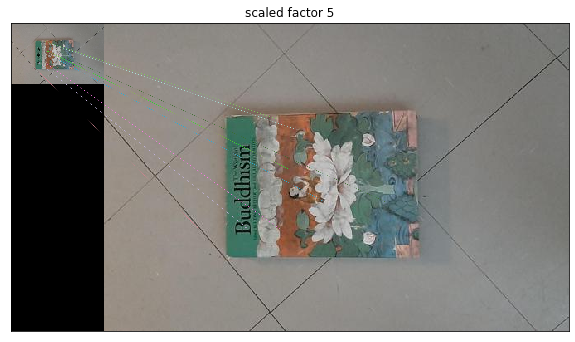

In [8]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();
for i in range (0, len(descriptors_list)):

    # here, only use matches[:10]
    img3 = cv2.drawMatches(img_book_background,keypoints_original,
                           imgs_resized[i],keypoints_list[i],
                           matches_list[i][:10], None, flags=2) 
    plt.figure(figsize=(10,10))
    plt.imshow(img3), plt.title("scaled factor " + str(scale[i])), plt.xticks([]), plt.yticks([])

### 7. Plot the matching distance for top 100 matched keypoints. Plot indices of keypoints on x-axis and corresponding matching distance on y-axis.

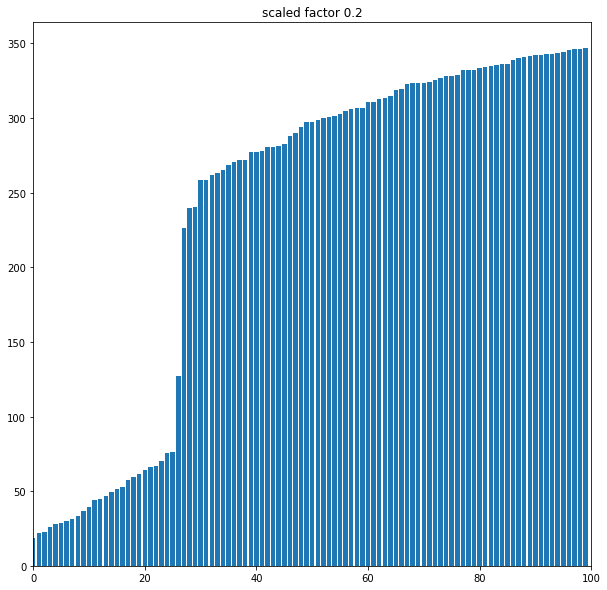

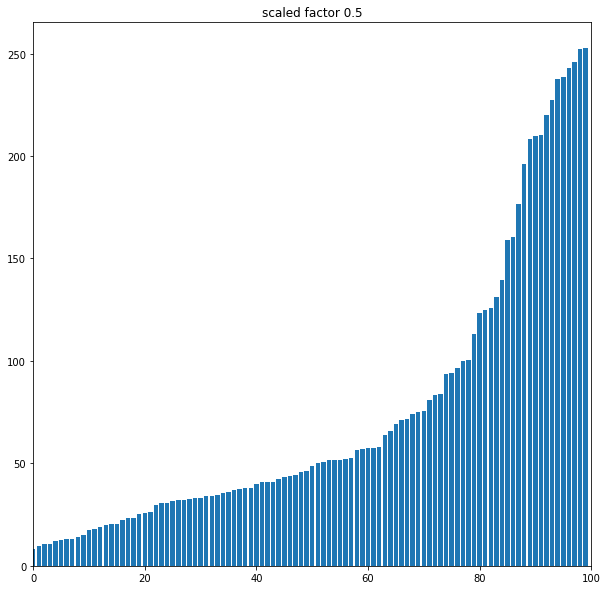

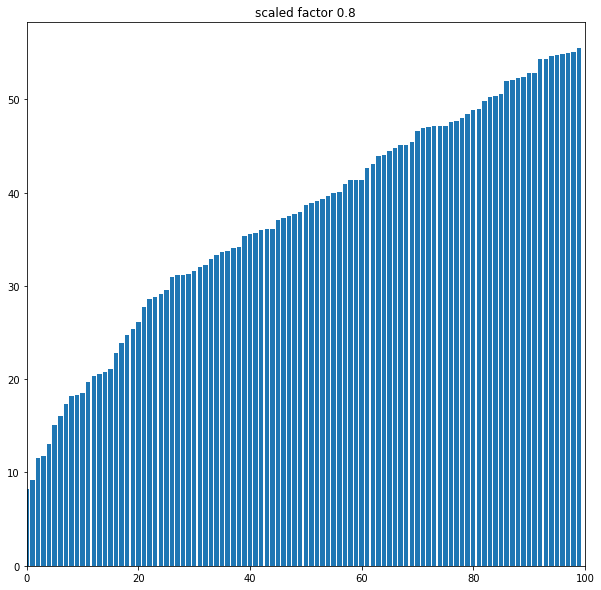

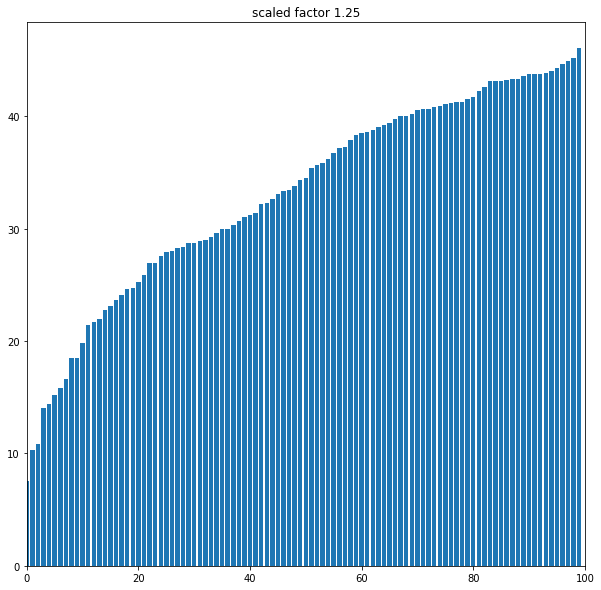

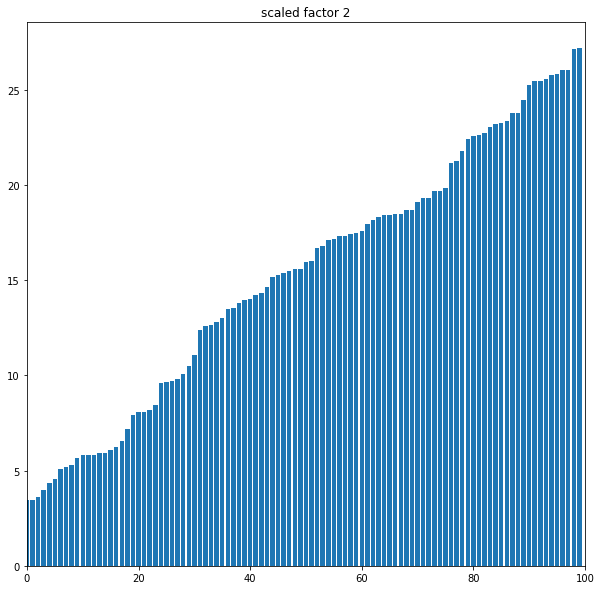

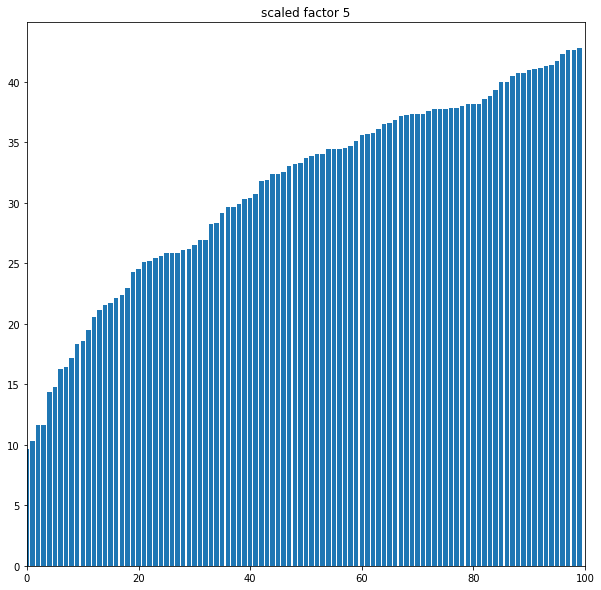

In [9]:
for i in range (0, len(descriptors_list)):
    
    # map each matchor to a single distance value in to a distance_list
    distance_list = map(lambda x:x.distance, matches_list[i])
    
    plt.figure(figsize=(10,10))
    
    # Have to convert the distance list to an array
    plt.bar(np.arange(0,100), np.asarray(list(distance_list)[:100]) )
    plt.title("scaled factor " + str(scale[i]))
    plt.xlim([0,100]) # set x-axis limit
    plt.show()

### 8. Discuss the trend in the plotted results. What is the effect of increasing the scale on the matching distance? Reason the cause.

1. Discuss the trend in the plotted results.<br>
The general trend of the plotted result is that by **increasing the scaling factor, the change of the least 100 distances are becoming smoother** (that means in the bar chart, 100 elements have more continuous values). Also, generally **enlarge the picture (scale > 1) returns smaller distance values than shrink the image (scale <1)**.
2. What is the effect of increasing the scale on the matching distance? Reason the cause.
Increasing the scale of image reduces the matching distance in general, but the scale has to be within a certain bound, meaning the scale can not go arbitrarily big. We can see from the six scale we chose, scales smaller than one (0.2, 0.5, 0.8) gives larger distance than scale larger than 1 (1.25, 2, 5). Although the closest features can be correctly mapped, we can see that if the scaling effect is to significant, the image pixels might be corrupted and we start to lose information about some keypoints. 0.2 is a good example because a sudden increase exists in its top 100 distance components, meaning there are a lot of bad matches.<br>
<br>
Another point to notice is that scale 2 gives closer distances than scale 5 and that is the reason the scaling factor can not go too large.<br>
<br>
The reason behind these two observations is related to how the image resize is done. Downscaling means several pixels in a neighbourhood are combined into one, and upscaling means 1 pixels is splited into several. In this case, we can see scale close to 1 performs generally well (like 0.8, 1.25) since recombination of pixel is moderate and features can be preserved. 0.2 gives poor performance is that the merging of pixels caused some features to be compromised. Lastly, scale 2 gives the best performance because it is still fairly close to 1. Also 2 is an integer, meaning one pixel should become a 2 * 2 = 4 square. Comparing to scale 5 (5 * 5) and 1.25 (not even an integer, meaning some pixels are not splited perfectly), scale 2 preserve the most features, thus keeps the descriptors in the most similar way, resulting in smallest distance

## 1.2 Invariance Under Rotation

### 1. Compute SIFT keypoints for the reference image.

note: since this section is very similar to part 1, thus at only crucial parts will be commented.

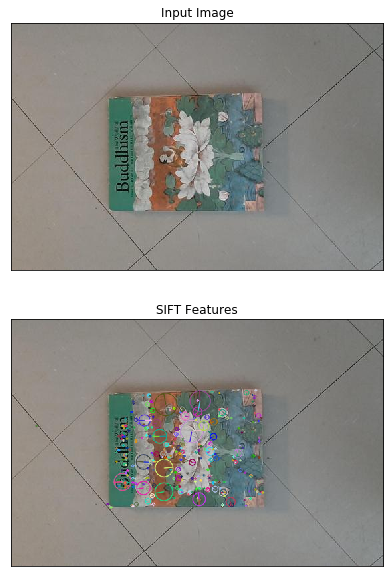

In [10]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();

sift = cv2.xfeatures2d.SIFT_create()
keypoints = sift.detect(img_book, None)
cv2.drawKeypoints(img_book, keypoints, img_book_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

# display
plt.figure(figsize=(10,10))
plt.subplot(211), plt.imshow(img_book)
plt.title("Input Image"), plt.xticks([]), plt.yticks([])
plt.subplot(212), plt.imshow(img_book_background)
plt.title("SIFT Features"), plt.xticks([]), plt.yticks([])
plt.show()


### 2. Rotate reference image at the angle of (10, 30, 90, 150, 170, 180).

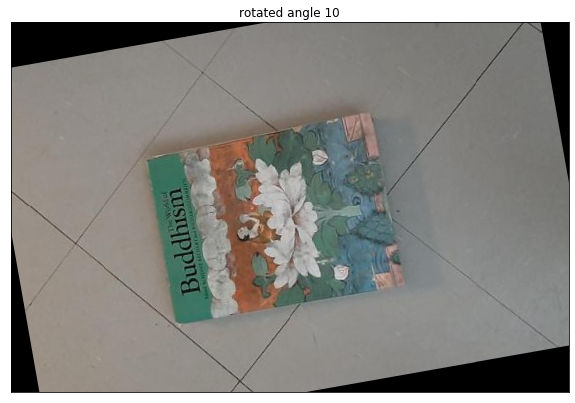

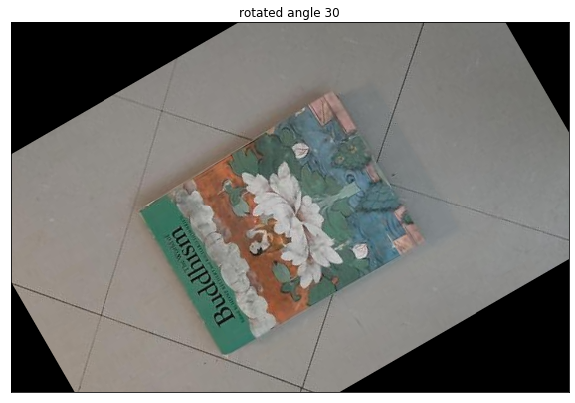

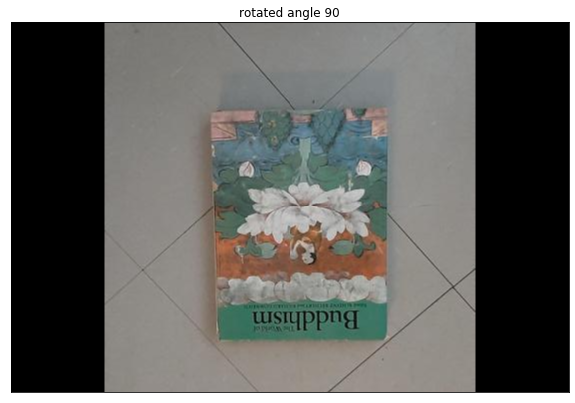

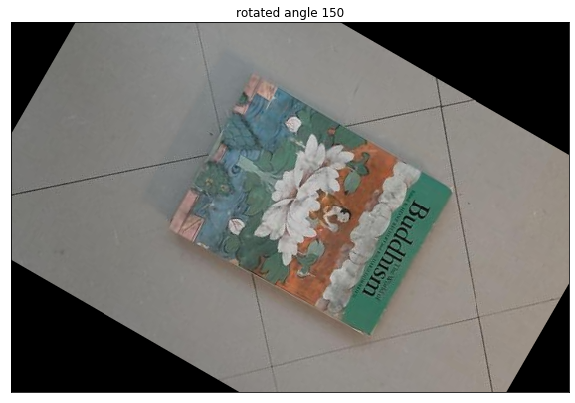

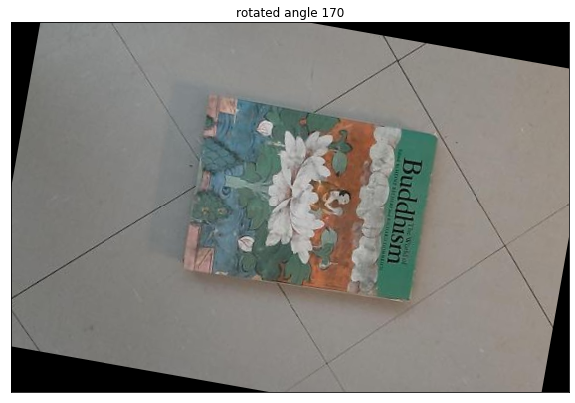

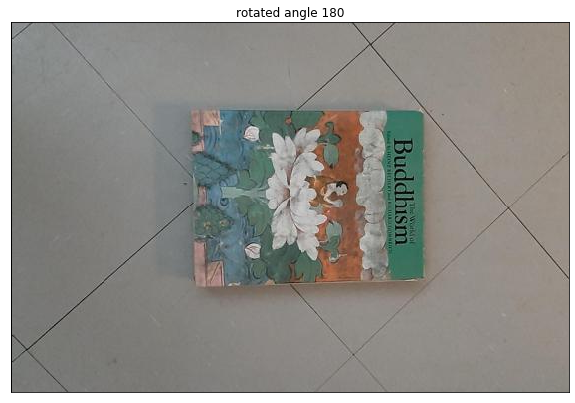

In [11]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
height = img_book.shape[0]
width = img_book.shape[1]

angle = [10, 30, 90, 150, 170, 180]

imgs_rotated = []

for an in angle:
    
    # get rotation matrix by input the angle value
    M = cv2.getRotationMatrix2D((width/2,height/2),an,1)
    
    # Apply the transformation matrix, this is essentially performing the rotating operation
    img2 = cv2.warpAffine(img_book,M,(width,height))
    
    imgs_rotated.append(img2)
    
    plt.figure(figsize=(10,10))
    plt.imshow(img2), plt.title("rotated angle " + str(an)), plt.xticks([]), plt.yticks([])

### 3. Compute SIFT keypoints for the transformed images.

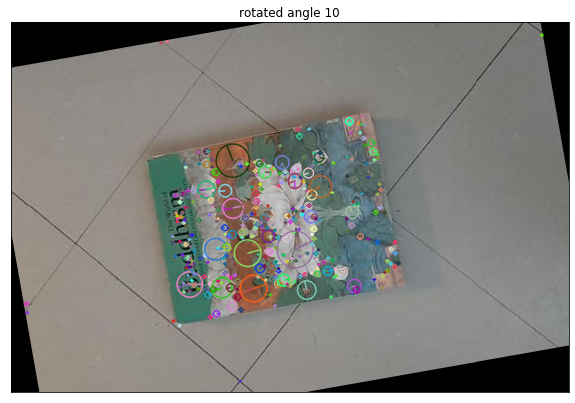

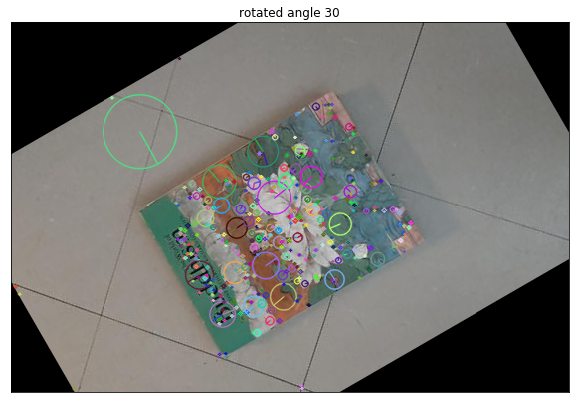

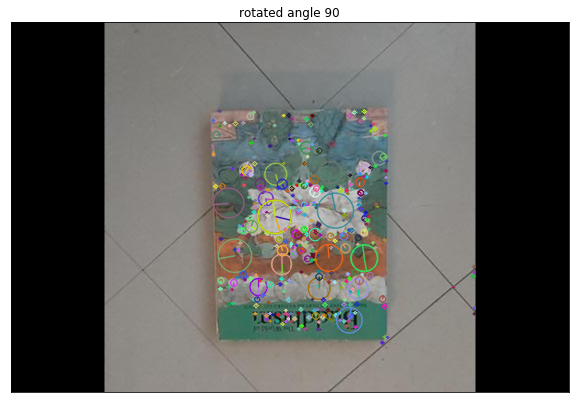

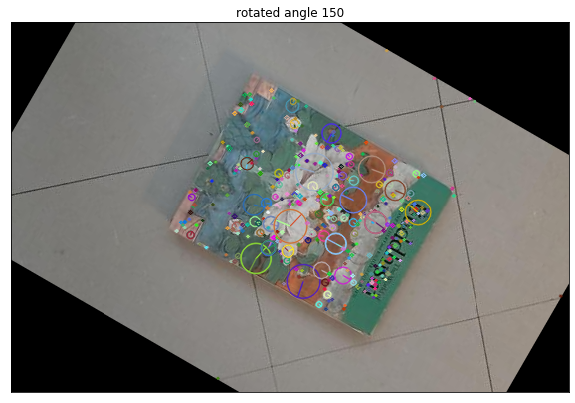

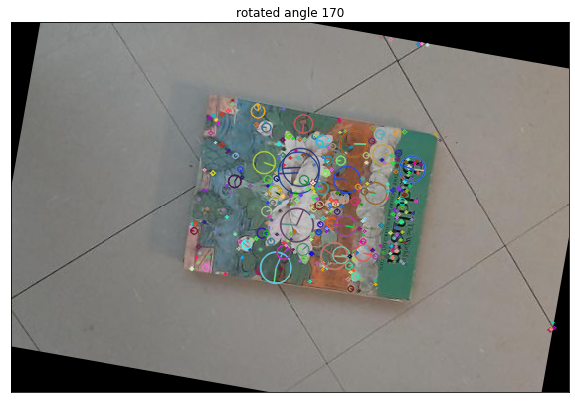

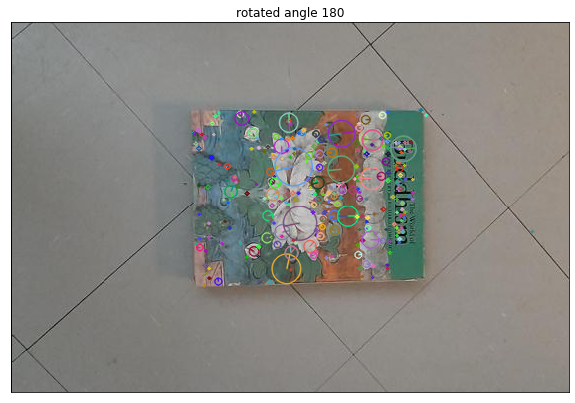

In [12]:
index = 0

ro_descriptors_list = []
ro_keypoints_list = []


for img in imgs_rotated:
    sift = cv2.xfeatures2d.SIFT_create()
    keypoints1,descriptors1 = sift.detectAndCompute(img,None)
    
    ro_descriptors_list.append(descriptors1)
    ro_keypoints_list.append(keypoints1)
 
    img_background = img.copy()

    cv2.drawKeypoints(img, keypoints1, img_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

    plt.figure(figsize=(10,10))
    plt.imshow(img_background), plt.title("rotated angle " + str(angle[index])), plt.xticks([]), plt.yticks([])
    
    index = index + 1; 

### 4. Match all keypoints of the reference image to the transformed images using a brute-force method.

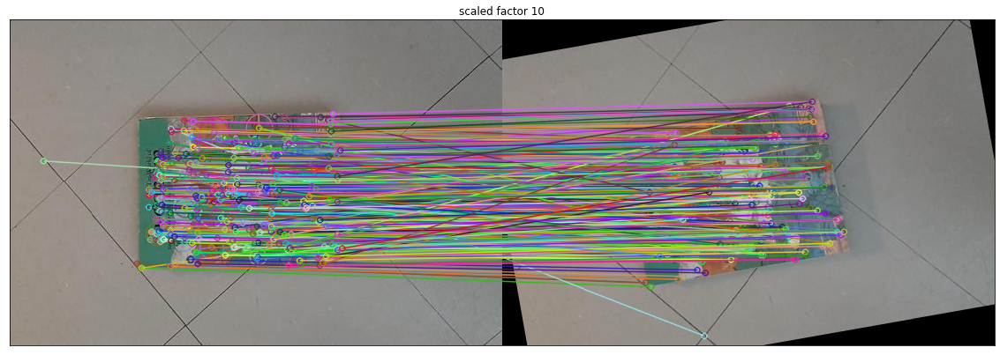

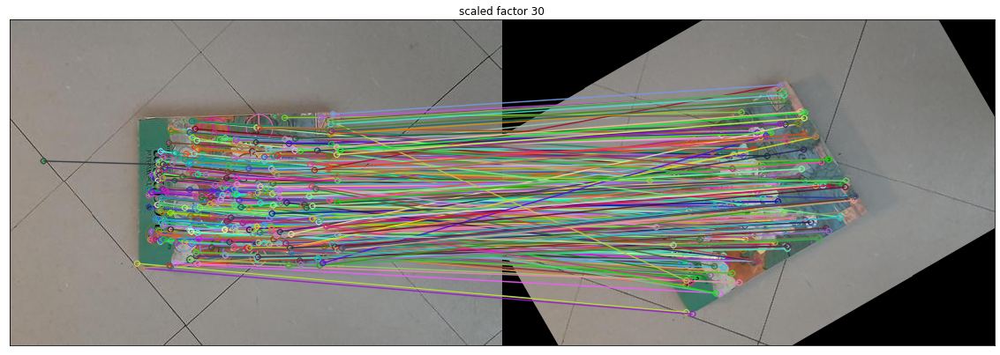

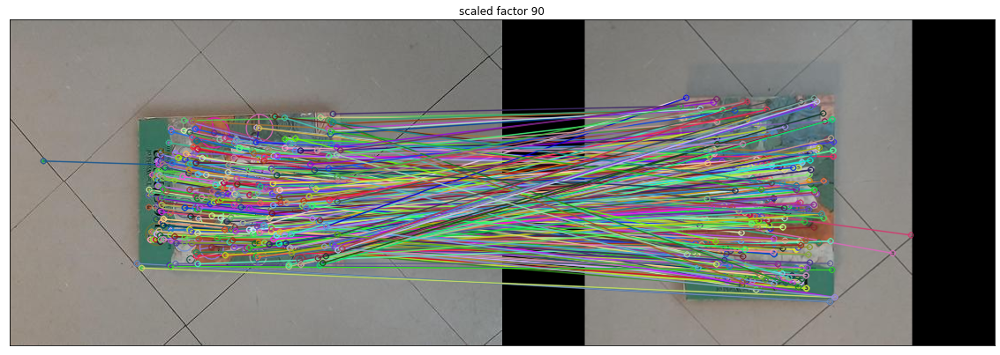

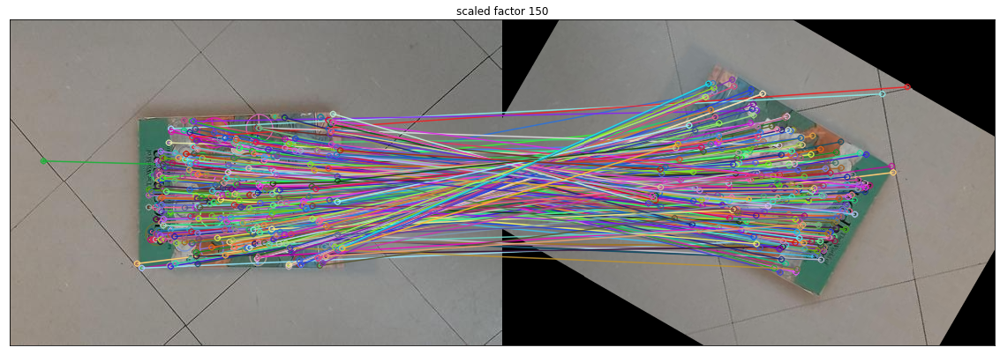

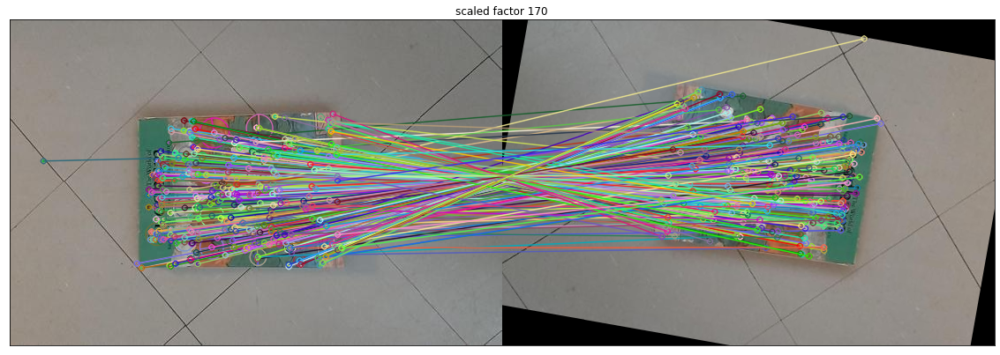

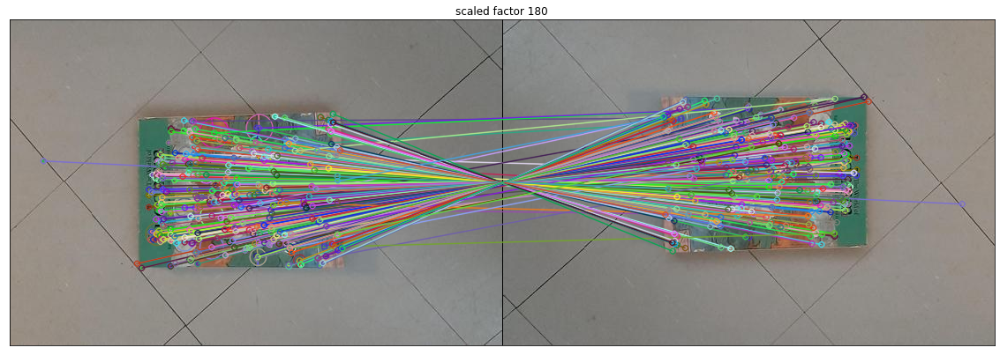

In [13]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();

ro_matches_list = []



sift = cv2.xfeatures2d.SIFT_create()
keypoints_original,descriptors_original = sift.detectAndCompute(img_book,None)

# draw the keypoints
cv2.drawKeypoints(img_book, keypoints_original, img_book_background, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

for i in range (0, len(ro_descriptors_list)):
    bf = cv2.BFMatcher()#cv2.NORM_HAMMING, crossCheck=True)
    matches = bf.match(descriptors_original,ro_descriptors_list[i])
    
    ro_matches_list.append(matches);
    
    img3 = cv2.drawMatches(img_book_background, keypoints_original,
                           imgs_rotated[i], ro_keypoints_list[i], 
                           matches, None, flags=2)
    plt.figure(figsize=(20,20))
    plt.imshow(img3), plt.title("scaled factor " + str(angle[i])), plt.xticks([]), plt.yticks([])

### 5. Sort matching keypoints according to the matching distance.

In [14]:
for i in range (0, len(angle)):
    ro_matches_list[i]  = sorted(ro_matches_list[i], key = lambda x:x.distance)
    print("for angle " + str(angle[i]) + " :")
    for j in range (0,5):
        
        print(ro_matches_list[i][j].distance)
    
    

for angle 10 :
11.532562255859375
12.12435531616211
12.247448921203613
13.076696395874023
13.416407585144043
for angle 30 :
8.062257766723633
8.246211051940918
11.269427299499512
12.529964447021484
12.806248664855957
for angle 90 :
14.0
19.10497283935547
19.595918655395508
19.748416900634766
21.189620971679688
for angle 150 :
11.224971771240234
13.076696395874023
14.696938514709473
18.220867156982422
18.248287200927734
for angle 170 :
9.219544410705566
9.433980941772461
11.180339813232422
11.661903381347656
12.449899673461914
for angle 180 :
0.0
0.0
0.0
0.0
0.0


### 6. Display top ten matched keypoints for each pair of reference image and a transformed image.

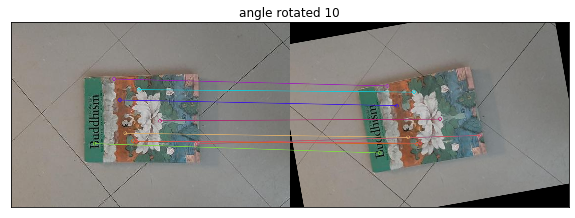

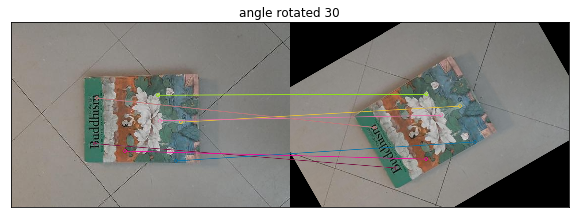

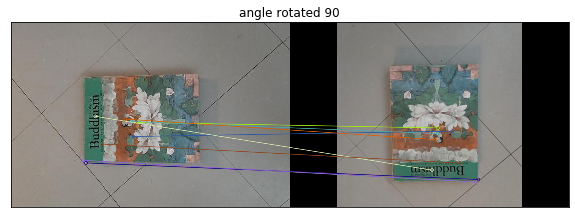

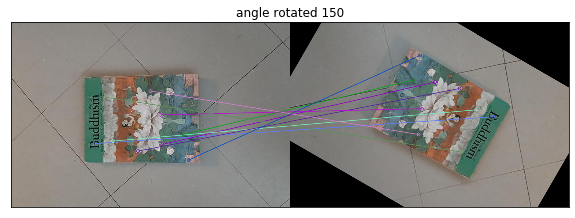

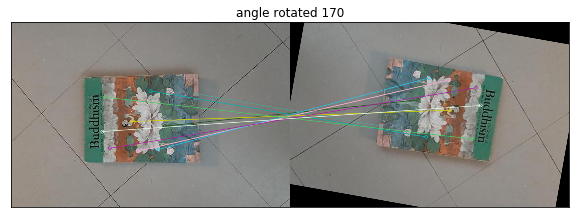

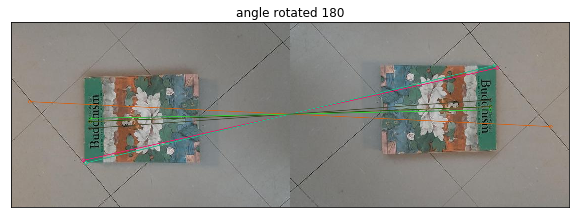

In [15]:
img_book = cv2.cvtColor(cv2.imread(path+"book.jpg"), cv2.COLOR_BGR2RGB)
img_book_background = img_book.copy();

for i in range (0, len(ro_descriptors_list)):
    img3 = cv2.drawMatches(img_book_background,keypoints_original,
                           imgs_rotated[i],ro_keypoints_list[i],
                           ro_matches_list[i][:10], None, flags=2)
    
    plt.figure(figsize=(10,10))
    plt.imshow(img3), plt.title("angle rotated " + str(angle[i])), plt.xticks([]), plt.yticks([])

### 7. Plot the matching distance for top 100 matched keypoints. Plot indices of keypoints on x-axis and corresponding matching distance on y-axis.

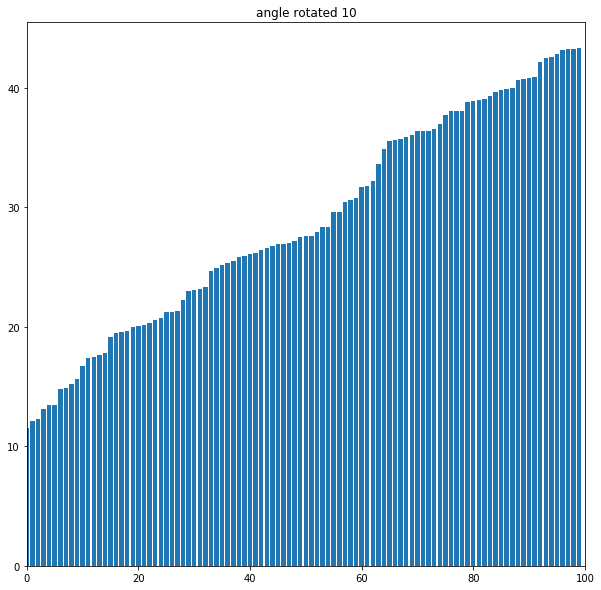

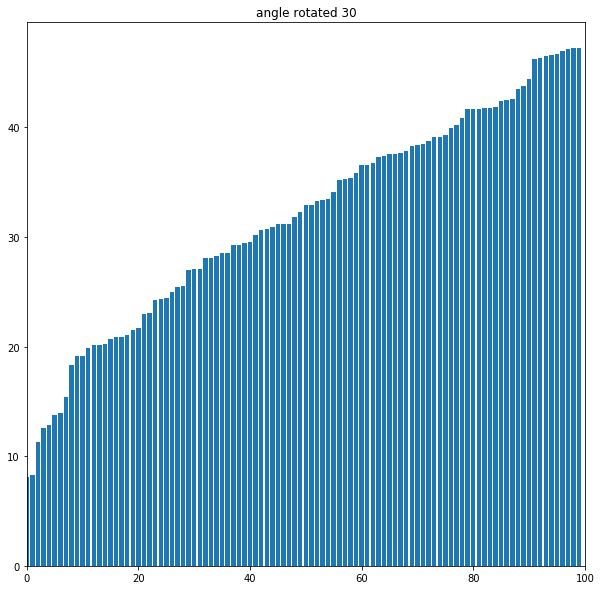

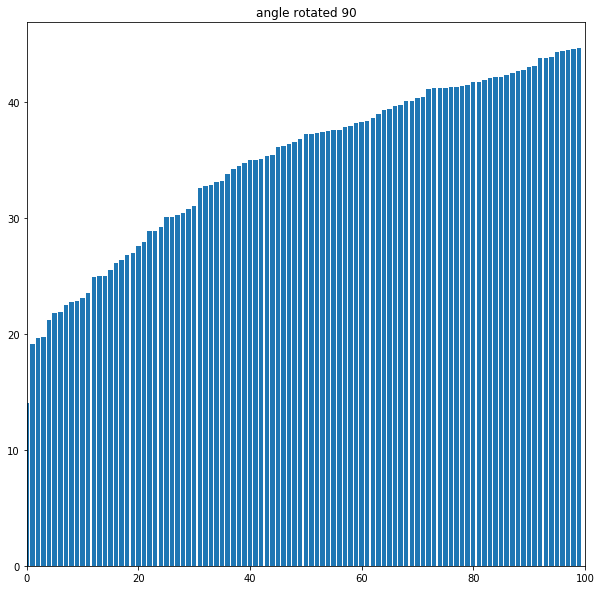

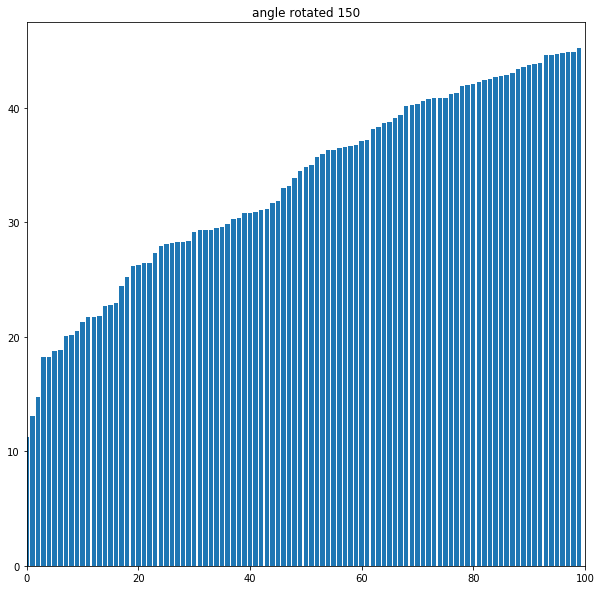

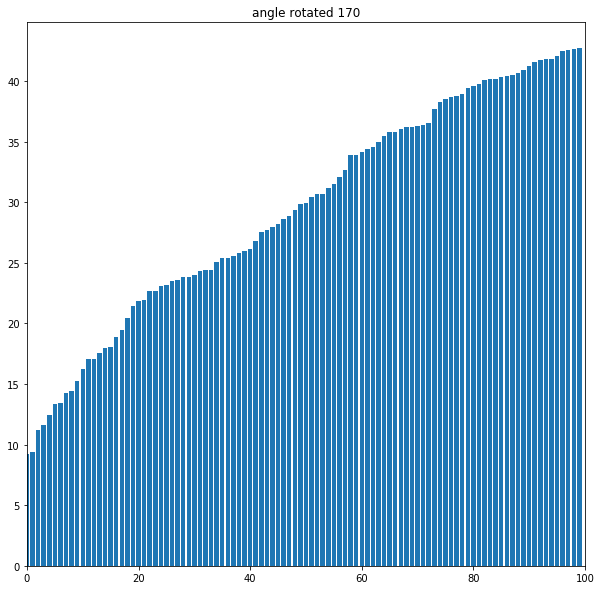

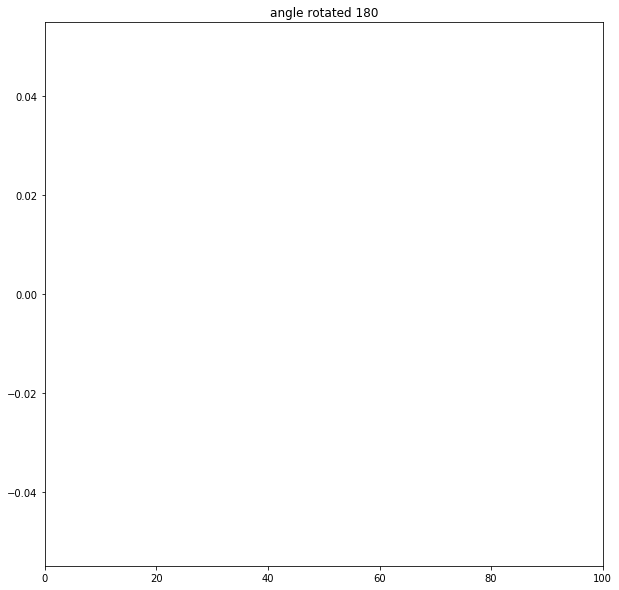

In [16]:
for i in range (0, len(ro_descriptors_list)):
    distance_list = map(lambda x:x.distance, ro_matches_list[i])
    
    plt.figure(figsize=(10,10))
    plt.bar(np.arange(0,100), np.asarray(list(distance_list)[:100]) )
    plt.title("angle rotated " + str(angle[i]))
    plt.xlim([0,100]) # set x-axis limit
    plt.show()

### 8. Discuss the trend in the plotted results. What is the effect of increasing the angle of rotation on the matching distance? Reason the cause. 

1. Discuss the trend in the plotted results.<br>
Over angles rotated from 0 to 180, the trend in the distances is the distance slowly increases and peaks at 90 degree. Then after 90 degree, distances decrease again and eventually reaches all zero for 180 degree. Overall the top 100 distances stays within a bound (from 0 - 50) and is not changing rapidly with the rotating angle.<br>
2. What is the effect of increasing the angle of rotation on the matching distance? Reason the cause.<br>
The SIFT descriptor should be invariant to the rotation and from the trend we can see the distances did not changed so much. The rotation, which changes the alignment and position of pixel, might generate some small calculation mistake when calculating the orientation histogram of the SFIT descriptor. 
<br>Thus, for rotated images which is closer to the x-axis (0, 180 degree), the distance is smaller than images far from the x-axis (30, 150). Rotation of 90 degree has the largest distance since it is the furthest from the aixs. 180 degree get zero distance since it is simply a reflection. All pixels are same except being repositioned thus all gradients and features are preserved in the same way.

## 2 Matching using SIFT - Book Reveal 
### 1. Find SIFT keypoints in given input images.

In [17]:
img_book_occluded = cv2.cvtColor(cv2.imread(path+"book_occlusion.jpg"), cv2.COLOR_BGR2RGB)
img_book_crop = cv2.cvtColor(cv2.imread(path+"book_crop.jpg"), cv2.COLOR_BGR2RGB)

(<matplotlib.image.AxesImage at 0x27201607608>,
 ([], <a list of 0 Text xticklabel objects>),
 ([], <a list of 0 Text yticklabel objects>))

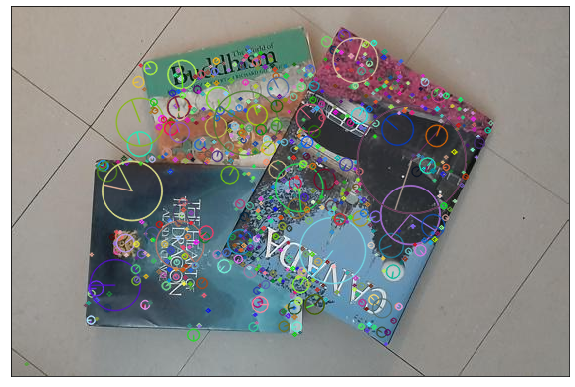

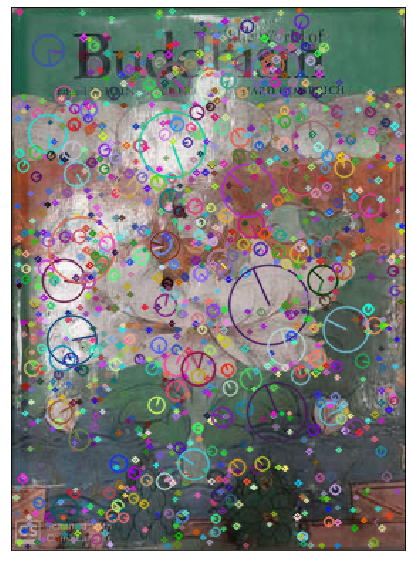

In [18]:
# Create a SIFT object
img_background_occ = img_book_occluded.copy()
img_background_crop = img_book_crop.copy()

# The parameter is set through trying:
# this set of parameter can guaruntee the least 10 distance matches are good matches
sift = cv2.xfeatures2d.SIFT_create(nOctaveLayers=9, contrastThreshold=0.02, edgeThreshold=10, sigma=2.2)

keypoints_occ,descriptors_occ = sift.detectAndCompute(img_book_occluded,None)
keypoints_crop,descriptors_crop = sift.detectAndCompute(img_book_crop,None)

cv2.drawKeypoints(img_book_occluded, keypoints_occ, img_background_occ, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2.drawKeypoints(img_book_crop, keypoints_crop, img_background_crop, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=(10,10))
plt.imshow(img_background_occ), plt.xticks([]), plt.yticks([])
plt.figure(figsize=(10,10))
plt.imshow(img_background_crop), plt.xticks([]), plt.yticks([])


### 2. Match keypoints of reference image to the keypoints of the occluded image using brute-force method.
### 3. Sort matching keypoints according to the matching distance.
Those two questions are combined below in the same code block

In [19]:
bf = cv2.BFMatcher(crossCheck=True)
matches = bf.match(descriptors_crop,descriptors_occ) #query image, train image
matches  = sorted(matches, key = lambda x:x.distance)

for i in range(0,10):
    print(matches[i].distance)

98.39207458496094
109.32063293457031
110.7926025390625
128.99612426757812
130.23825073242188
135.4769287109375
141.10633850097656
141.97183227539062
149.1073455810547
150.45265197753906


### 4. Display top ten matching keypoints. 

After plotting out the top 10 match point, we can see all matches are correct matches (which means, points matches to the same book at the same position). Thus we will use these 10 points to solve homography.

(<matplotlib.image.AxesImage at 0x27203e9bfc8>,
 ([], <a list of 0 Text xticklabel objects>),
 ([], <a list of 0 Text yticklabel objects>))

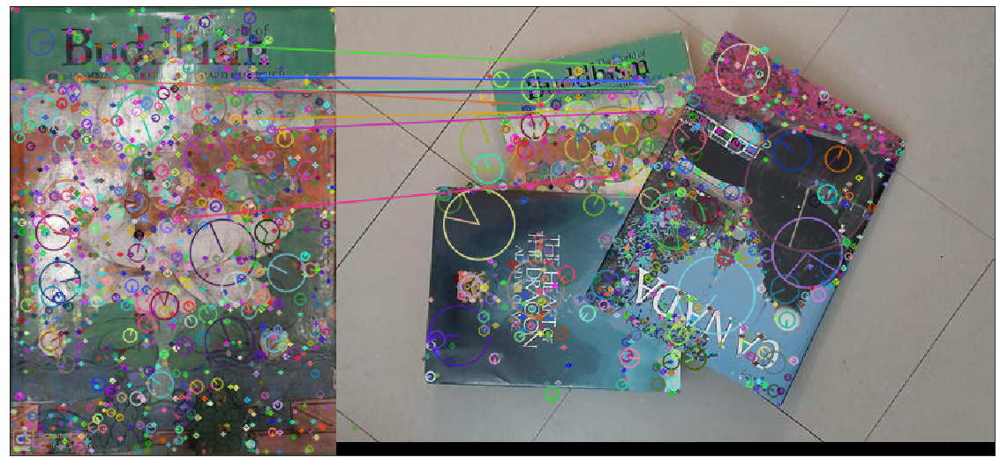

In [20]:
matches_img = cv2.drawMatches(img_background_crop,keypoints_crop,
                           img_background_occ,keypoints_occ,
                           matches[:10], None, flags=2)
plt.figure(figsize=(20,20))
plt.imshow(matches_img), plt.xticks([]), plt.yticks([])

### 5. Compute a homography to align the images using RANSAC method and apply the transformation on the reference image.

(<matplotlib.image.AxesImage at 0x27203e67a48>,
 ([], <a list of 0 Text xticklabel objects>),
 ([], <a list of 0 Text yticklabel objects>))

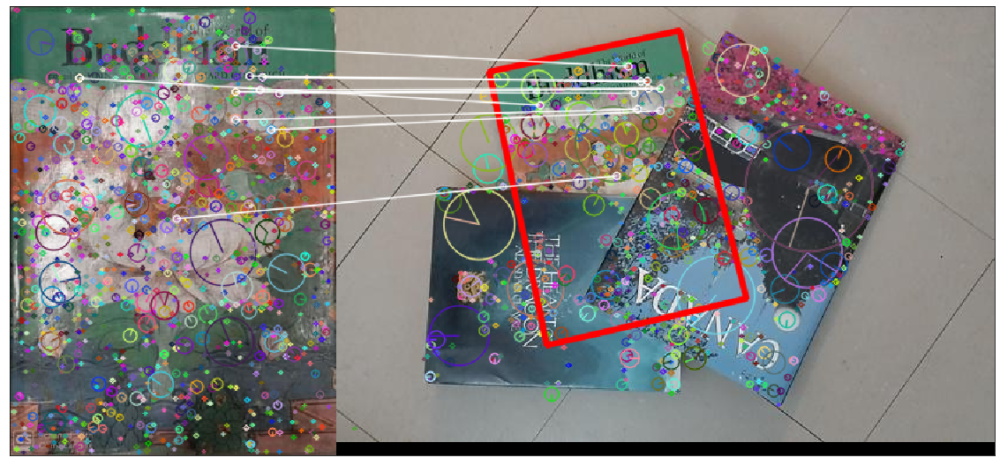

In [21]:
# The number of SIFT points used in RANSAC homography solving
no_point = 10

source_point = []
destinate_point = []

# read points in two lists, later convert to arrays to solve homography
for i in range(0,no_point):
    m = matches[i]
    source_point.append(np.float32( keypoints_crop[m.queryIdx].pt))
    destinate_point.append(np.float32( keypoints_occ[m.trainIdx].pt))
    
# solve homography
# M is the transform matrix
M, mask = cv2.findHomography(np.asarray(source_point), np.asarray(destinate_point), cv2.RANSAC,5.0)
matchesMask = mask.ravel().tolist()
draw_params = dict(matchColor = (255,255,255), 
                   singlePointColor = None,
                   matchesMask = matchesMask, 
                   flags = 2)

# here, map original dimension by transforming using matrix M
h,w = img_background_crop.shape[0:2]
pts = np.float32([ [0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)
dst = cv2.perspectiveTransform(pts,M)

img_background_occ = cv2.polylines(img_background_occ,[np.int32(dst)],True,255,3, cv2.LINE_AA)

img3 = cv2.drawMatches(img_background_crop,keypoints_crop,img_background_occ,keypoints_occ,matches[:10],None,**draw_params)

plt.figure(figsize=(20,20))
plt.imshow(img3), plt.xticks([]), plt.yticks([])

### 6. Paste transformed reference image on the occluded view to generate unoccluded view as shown in Figure 2(c).

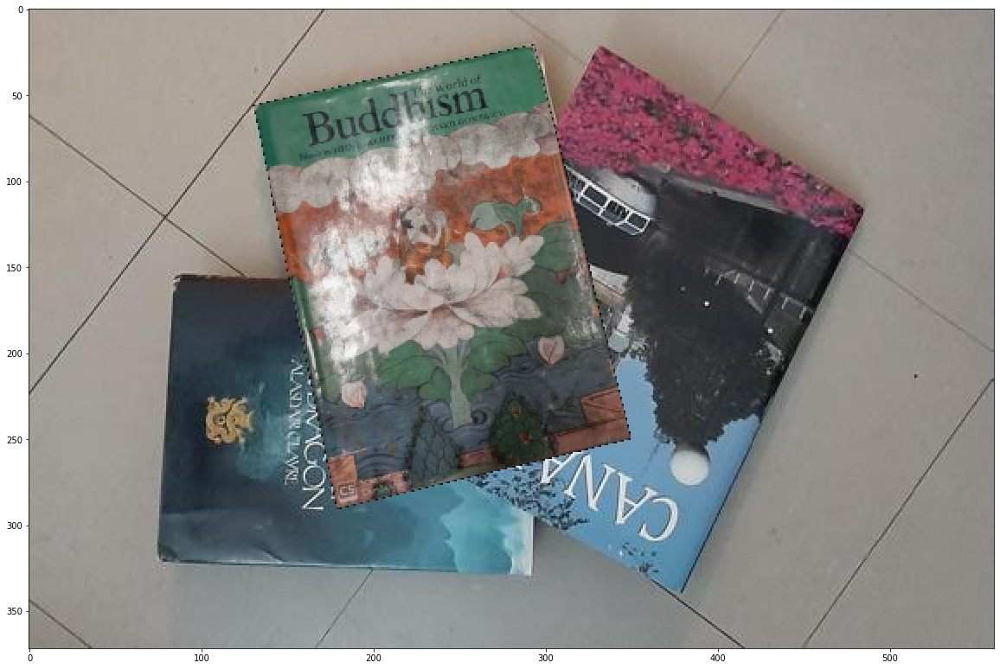

In [22]:
# this step tranform the crop book to the position in the occulude image
warped = cv2.warpPerspective(img_book_crop,M,(img_background_occ.shape[1], img_background_occ.shape[0]))

# fill the rest of the pixel with original picture
for i in range(img_background_occ.shape[0]):
    for j in range(img_background_occ.shape[1]):
        for k in range(img_background_occ.shape[2]):
            if(warped[i,j,k] == 0):
                warped[i,j,k] = img_book_occluded[i,j,k]
                
plt.figure(figsize=(20,20))
plt.imshow(warped)

## 3 Face detection 
### 3.1 Eigenface Representation

there are 100 pictures in the list
each picture have the dimension of (218, 178)


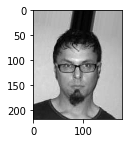

In [23]:
# select randomly 100 images from celebA_subset
import random
random.seed(20)

celeA_path = path + "celebA_subset/"
number_of_image = 100

celeA_list = []

for i in random.sample(range(0, 10000), number_of_image):
    img = cv2.imread(celeA_path + format(i, '06d') + ".jpg", cv2.IMREAD_GRAYSCALE)
    celeA_list.append(img)

print("there are " + str(len(celeA_list)) +" pictures in the list")
print("each picture have the dimension of " + str(celeA_list[0].shape))
plt.figure(figsize=(2,2))
plt.imshow(celeA_list[0], cmap=plt.cm.gray)

In [24]:
D = np.zeros((celeA_list[0].shape[0] * celeA_list[0].shape[1], number_of_image),dtype=float)

# Calculate average face
average_face =  np.zeros((celeA_list[0].shape[0] * celeA_list[0].shape[1]),dtype=float)
for i in range(0, 100):  
    average_face = average_face +  celeA_list[i].flatten()
average_face = average_face /100


# Here we construct D matrix using normalised face vector
for i in range(0, number_of_image):
    img2 = celeA_list[i].flatten()
    D[:,i] = (img2 - average_face)/ np.linalg.norm(img2 - average_face)

# construct Dt_D: the covariance Matrix using snapshot method
Dt_D = np.transpose(D).dot(D)
# check size of Dt_D, should be 100*100
print(Dt_D.shape)

(100, 100)


In [25]:
# find eigenvalue and eigenvectors
eig_val, Dt_v = np.linalg.eig(Dt_D)

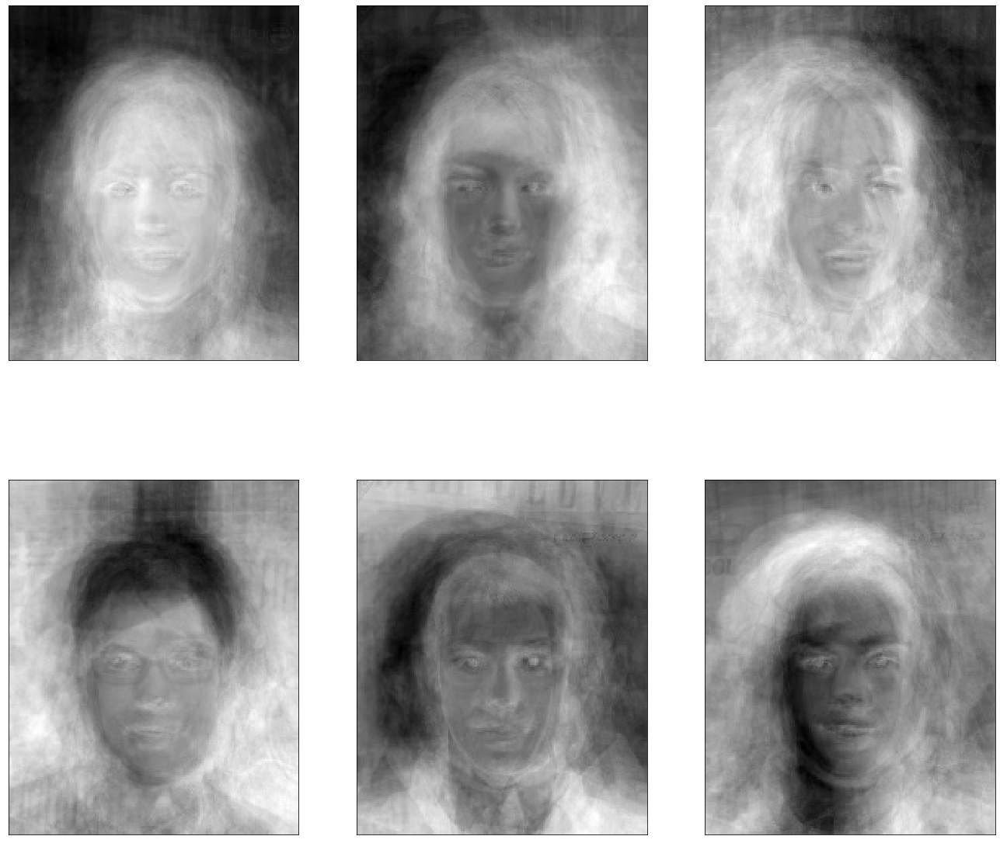

In [26]:
# eigenface stored in this list
eigenfaces_list = []
# Specifiy the number of eigenface used, this variable will propagate in later operations
number_of_eigface = 20

# first 20 column in Dt_v
Dt_selected_eigenf = Dt_v[:, 0:number_of_eigface]

for i in range(0, number_of_eigface):
    # times D to recover the origin eigenface. Add them in a list for later detection
    recovered = D.dot(Dt_v[:,i])
    eigenfaces_list.append(recovered/ np.linalg.norm(recovered))
    
# Print first 6 eigenfaces
plt.figure(figsize=(9 * 2, 6 * 3))
plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.1)
for i in range(0, 6):
    plt.subplot(2,3, i+1)
    plt.imshow(eigenfaces_list[i].reshape(celeA_list[0].shape[0] , celeA_list[0].shape[1]), cmap=plt.cm.gray)
    plt.xticks(())
    plt.yticks(())

### 3.2 Face Detection
#### Eigenface method using a sliding window

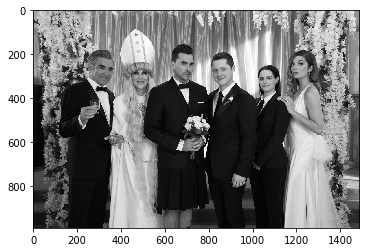

In [27]:
# read original message
total_img = cv2.imread(path + "schitt's_creek_group_photo.jpeg", cv2.IMREAD_GRAYSCALE)
plt.figure()
plt.imshow(total_img, cmap=plt.cm.gray)

# load size of the large image
H,W = total_img.shape
# load size of each window, we make the window size to be the same as each face profile 
h_window,w_window = celeA_list[0].shape
# increment of the slide window
step_pixel = 20

error_list = []
coor_list = []

for i in range(0, W - w_window , step_pixel):# width
    for j in range (0, H -h_window, step_pixel): # hight
        
        # read and normalize v
        current_window = total_img[j:j+h_window, i:i+w_window].copy()
        current_window_v = current_window.flatten() #38804,1
        normalized_cwv = (current_window_v- average_face) / np.linalg.norm(current_window_v- average_face) 
       
        # multipy Dt to vector v
        Dt_input = np.transpose(D).dot(normalized_cwv) # 100*38804 dot 38804*1 = 100*1
        
        # project onto eigenfaces
        parameter = np.transpose(Dt_input).dot(Dt_selected_eigenf)# 1*100 dot 100*20 = 20
        
        
        # calculate sum of square error
        error_vector = normalized_cwv - sum(parameter[a] * eigenfaces_list[a].flatten() 
                                                           for a in range (0, number_of_eigface))
        sum_square_error = np.sum(error_vector**2)
       
        error_list.append(sum_square_error)
        coor_list.append((j,i))

(160, 0)
(180, 0)
(160, 20)
(180, 20)
(160, 40)
(180, 40)
(160, 120)
(180, 120)
(140, 140)
(160, 140)
(140, 160)
(160, 160)
(160, 180)
(160, 200)
(240, 440)
(180, 520)
(140, 540)
(160, 540)
(180, 540)
(200, 540)
(0, 560)
(20, 560)
(40, 560)
(60, 560)
(140, 560)
(160, 560)
(180, 560)
(200, 560)
(20, 580)
(40, 580)
(160, 580)
(180, 580)
(180, 600)
(200, 680)
(260, 1000)
(220, 1020)
(240, 1020)
(260, 1020)
(280, 1020)
(240, 1040)
(260, 1040)
(280, 1040)
(300, 1040)
(140, 1080)
(160, 1080)
(180, 1080)
(140, 1100)
(160, 1100)
(180, 1100)
(160, 1140)
(180, 1140)
(140, 1160)
(160, 1160)
(160, 1180)
(180, 1180)
(200, 1180)
(220, 1180)


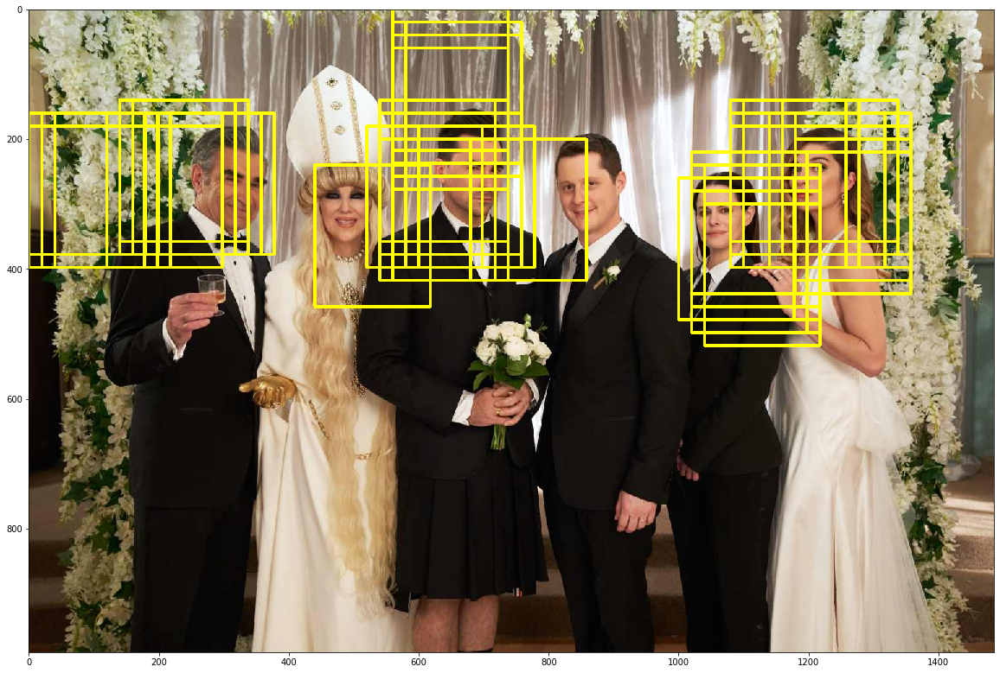

In [28]:
total_img_background = cv2.cvtColor(cv2.imread(path + "schitt's_creek_group_photo.jpeg"), cv2.COLOR_BGR2RGB)

threshold = 1.13


for error in error_list:
    if(error < threshold):
        
        
        
        # find window with small error
        index = error_list.index(error)
        coor = coor_list[index]
        
        print(coor)
        
        # put box on the "desired" window
        cv2.rectangle(total_img_background , (coor[1], coor[0]), (coor[1]+ w_window, coor[0] + h_window), (255,255,0), 3)
       
        
plt.figure(figsize=(20,20))
plt.imshow(total_img_background)

In [ ]:
# Cluster detection windows into neighbours:
def make_neighbourhood():
    

#### Analysis about the Eigenface face detection
1. After tweaking the threshold, the final result which keeps the most window with face is 1.13. If the thresold is lower than this value, the lady with the white hat will not be included.
2. Based on the clustring of the rectangles, I concluded then into 8 main detections. 5 of then contains good face recognition and the rest 3 contains either no face or part of someone's face with the center of the image showing something else. Please see the next 2 sections. Note that all coordinates are selected from the list printed from last section.

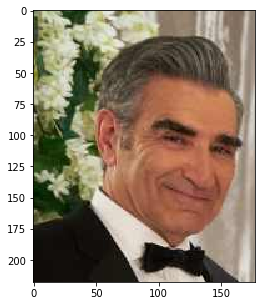

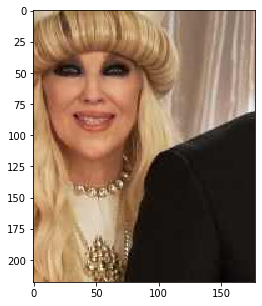

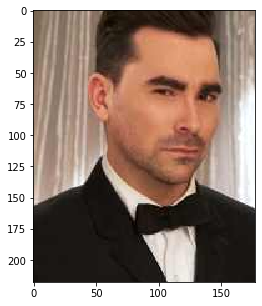

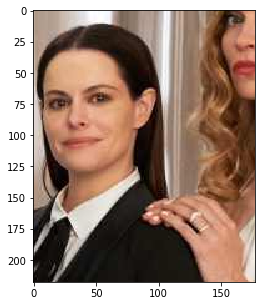

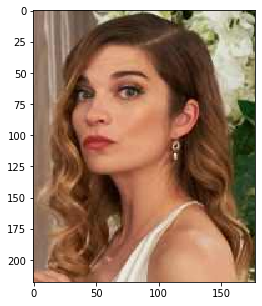

In [29]:
total_img_original = cv2.cvtColor(cv2.imread(path + "schitt's_creek_group_photo.jpeg"), cv2.COLOR_BGR2RGB)
# Show 5 good detection:

# 1 leftmost gentleman
coor1 = (160,200)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor1[0]:coor1[0]+h_window, coor1[1]: coor1[1]+ w_window])

# 2 lady with white hat
coor2 = (240,440)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor2[0]:coor2[0]+h_window, coor2[1]: coor2[1]+ w_window])

# 3 gentleman holding flower
coor3 = (180, 580)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor3[0]:coor3[0]+h_window, coor3[1]: coor3[1]+ w_window])

# 4 lady in suit
coor4 = (240, 1020)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor4[0]:coor4[0]+h_window, coor4[1]: coor4[1]+ w_window])

# 5 lady in dress
coor5 = (180, 1140)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor5[0]:coor5[0]+h_window, coor5[1]: coor5[1]+ w_window])

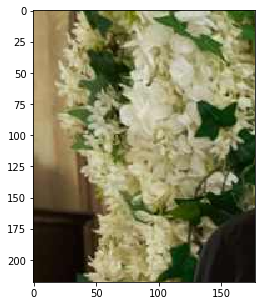

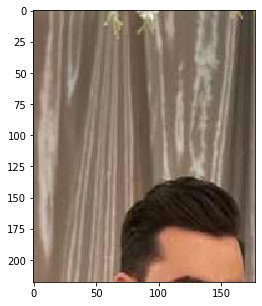

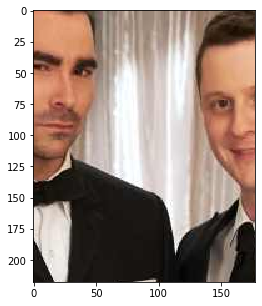

In [30]:
# Show 3 bad/false detection:

# 1 leftmost flower
coor1_f = (180, 0)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor1_f[0]:coor1_f[0]+h_window, coor1_f[1]: coor1_f[1]+ w_window])

# 2 region above "gentleman holding flower". 
# Though it capture the forehead of that gentleman, but the center of that image is on the curtain, thus a bad detection
coor2f = (20, 560)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor2f[0]:coor2f[0]+h_window, coor2f[1]: coor2f[1]+ w_window])

# 3 region between two gentlemen
# though this window captures two faces partially, the center of the window is the hightlighted curtain thus a bad detection
coor3f = (200, 680)
plt.figure(figsize=(5,5))
plt.imshow(total_img_original[coor3f[0]:coor3f[0]+h_window, coor3f[1]: coor3f[1]+ w_window])

1. The detection works generally OK. In total there are 6 faces and it successfully detected 5 of them. It do have some defects. A defect is that when the illuination around the face is very high, like the white hat of the lady and the light projected on the curtain, it becomes a bit hard to recognise the face (error start to go beyond threshold). 
2. From the above anaysis, the detection got **3 false positives** which returns window without a face in the center. (For simplicity, I did not count all windows since some of they are repetitions but simply those 8 most representitive detections.)

#### viola-Jones detector
Note: need to put **'haarcascade_frontalface_default.xml'** in the same directory as other images used.

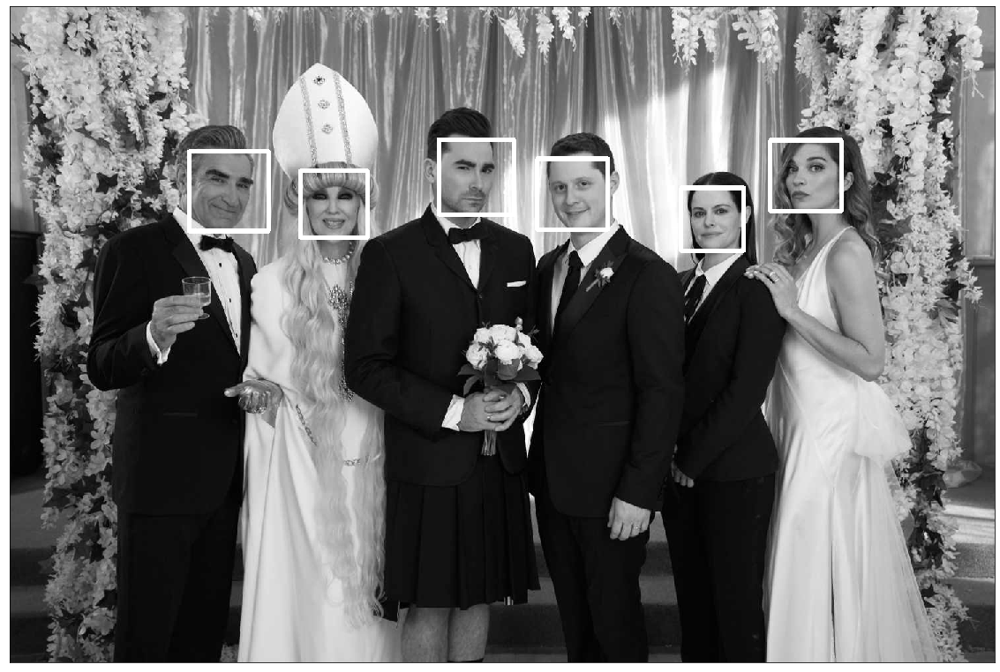

In [31]:
# Code Credit:
# ECSE 415 tutorial 4
face_cascade = cv2.CascadeClassifier(path+'haarcascade_frontalface_default.xml')
img = cv2.imread(path+"schitt's_creek_group_photo.jpeg")
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# this set of parameter is configurated to get all correct result without any false positives
faces = face_cascade.detectMultiScale(gray, 1.1, 8, minSize = (70,70))

for (x,y,w,h) in faces:
    gray = cv2.rectangle(gray,(x,y),(x+w,y+h),(255,0,0),5)
    
plt.figure(figsize=(20,20))
plt.imshow(gray, cmap="gray")
plt.xticks(())
plt.yticks(())
plt.show()

For viola-jones detector, after configurating the parameters, **the detector successfully detected all faces with zero false positive**.

#### Under what conditions would you expect the Viola-Jones detector to work when PCA does not? 
1. First, when the **image used for detection is large**, for example a large panorama on the street, then the eigenface detection might not work since checks needs to be made window by window which can be slow. Viola jones can reject non-faces at different stages, thus allowing faster detection.
2. Second, when **faces in to detect has different sizes**, like some faces closer in the viewpoint (thus appear larger) and some further away. Since eigenface are trained using dataset containing face in relative same size, thus for some smaller face the detection might be hard. The size of the window need to be adjusted dynamically in this case.
3. third, **if the face is under extreme background (strong white, for example)**. This is what happened in my eigenface detector. The eigenface are trained with faces under random backgrounds. When a face with extreme background is projected, there might be additional error introduced on the background causing the error to exceed threshold.

In [32]:
  
# -*- coding:utf-8 -*-
# Author:Richard Fang

import time
import numpy as np
import torch


def soft_nms_pytorch(dets, box_scores, sigma=0.5, thresh=0.001, cuda=0):
    """
    Build a pytorch implement of Soft NMS algorithm.
    # Augments
        dets:        boxes coordinate tensor (format:[y1, x1, y2, x2])
        box_scores:  box score tensors
        sigma:       variance of Gaussian function
        thresh:      score thresh
        cuda:        CUDA flag
    # Return
        the index of the selected boxes
    """

    # Indexes concatenate boxes with the last column
    N = dets.shape[0]
    if cuda:
        indexes = torch.arange(0, N, dtype=torch.float).cuda().view(N, 1)
    else:
        indexes = torch.arange(0, N, dtype=torch.float).view(N, 1)
    dets = torch.cat((dets, indexes), dim=1)

    # The order of boxes coordinate is [y1,x1,y2,x2]
    y1 = dets[:, 0]
    x1 = dets[:, 1]
    y2 = dets[:, 2]
    x2 = dets[:, 3]
    scores = box_scores
    areas = (x2 - x1 + 1) * (y2 - y1 + 1)

    for i in range(N):
        # intermediate parameters for later parameters exchange
        tscore = scores[i].clone()
        pos = i + 1

        if i != N - 1:
            maxscore, maxpos = torch.max(scores[pos:], dim=0)
            if tscore < maxscore:
                dets[i], dets[maxpos.item() + i + 1] = dets[maxpos.item() + i + 1].clone(), dets[i].clone()
                scores[i], scores[maxpos.item() + i + 1] = scores[maxpos.item() + i + 1].clone(), scores[i].clone()
                areas[i], areas[maxpos + i + 1] = areas[maxpos + i + 1].clone(), areas[i].clone()

        # IoU calculate
        yy1 = np.maximum(dets[i, 0].to("cpu").numpy(), dets[pos:, 0].to("cpu").numpy())
        xx1 = np.maximum(dets[i, 1].to("cpu").numpy(), dets[pos:, 1].to("cpu").numpy())
        yy2 = np.minimum(dets[i, 2].to("cpu").numpy(), dets[pos:, 2].to("cpu").numpy())
        xx2 = np.minimum(dets[i, 3].to("cpu").numpy(), dets[pos:, 3].to("cpu").numpy())
        
        w = np.maximum(0.0, xx2 - xx1 + 1)
        h = np.maximum(0.0, yy2 - yy1 + 1)
        inter = torch.tensor(w * h).cuda() if cuda else torch.tensor(w * h)
        ovr = torch.div(inter, (areas[i] + areas[pos:] - inter))

        # Gaussian decay
        weight = torch.exp(-(ovr * ovr) / sigma)
        scores[pos:] = weight * scores[pos:]

    # select the boxes and keep the corresponding indexes
    keep = dets[:, 4][scores > thresh].int()

    return keep


def speed():
    boxes = 1000*torch.rand((1000, 100, 4), dtype=torch.float)
    boxscores = torch.rand((1000, 100), dtype=torch.float)

    # cuda flag
    cuda = 1 if torch.cuda.is_available() else 0
    if cuda:
        boxes = boxes.cuda()
        boxscores = boxscores.cuda()

    start = time.time()
    for i in range(1000):
        soft_nms_pytorch(boxes[i], boxscores[i], cuda=cuda)
    end = time.time()
    print("Average run time: %f ms" % (end-start))


def test():
    # boxes and boxscores
    boxes = torch.tensor([[200, 200, 400, 400],
                          [220, 220, 420, 420],
                          [200, 240, 400, 440],
                          [240, 200, 440, 400],
                          [1, 1, 2, 2]], dtype=torch.float)
    boxscores = torch.tensor([0.8, 0.7, 0.6, 0.5, 0.9], dtype=torch.float)

    # cuda flag
    cuda = 1 if torch.cuda.is_available() else 0
    if cuda:
        boxes = boxes.cuda()
        boxscores = boxscores.cuda()

    print(soft_nms_pytorch(boxes, boxscores, cuda=cuda))


if __name__ == '__main__':
    test()
    # speed()



tensor([4, 0, 1, 2, 3], device='cuda:0', dtype=torch.int32)
